In [16]:
from matplotlib import pyplot as plt

# USAGE
# python recognize_faces_image.py --encodings encodings.pickle --image examples/example_01.png 

# import the necessary packages
import face_recognition
import pickle
import cv2
from imutils import paths # to get paths
import os
import numpy
import time
import pandas as pd

# for cross-functions
from cv2 import dnn_superres
from matplotlib import pyplot as plt
from PIL import Image
import warnings

def show_image(title, img):
      show = img[:,:,::-1] # needed to reverse colour properly. select all the elements on the first axis, all the elements on the seconds, and then the reverse of the elements on the third axis.
      plt.imshow(show)
      plt.title(title)
      plt.show()

def optimizeImage(imagePath, modelPath):
    # Create an SR object
    sr = dnn_superres.DnnSuperResImpl_create()
    
    # Get model name, get text between '/' & '_'
    modelName = modelPath.split('/')[1].split('_')[0].lower()

    # Get scale
    scale = int(modelPath.split('/')[1].split('_')[1].split('.')[0][1])

    # Read image
    image = cv2.imread(imagePath)
    
    # Read the desired model
    sr.readModel(modelPath)

    # Set the desired model and scale to get correct pre- and post-processing
    sr.setModel(modelName, scale)

    # Upscale the image
    result = sr.upsample(image)

    # Save the image (optional)
    #cv2.imwrite("./examples/upscaled-fsrcnn_x4.jpg", result)
    
    return result

## for use in bicubic START
def scaleImage(imagePath, factor, algorithm):
    # Read image
    image = Image.open(imagePath)
    imgSize = (image.width * factor, image.height * factor)

    # Upscale the image
    result = image.resize(imgSize, algorithm)

    return result

# for non-opencv use
def display_image(title, img):
      plt.imshow(img)
      plt.title(title)
      plt.show()
## for use in bicubic END

# detection_mode: # variable for setting detection method, either: 'scale', 'ai', or anything else for 'direct'
def recognize_face(detection_mode, dataset):
    encodings = "encodings.pickle"
    detection_method = "hog"
    imagePaths = list(paths.list_images(dataset))
    
    # benchmark time
    start_time = time.time()
    # variables for detection accuracy
    identify_correct = 0
    identify_wrong = 0
    identify_none = 0
    count = 0

    # load the known faces and embeddings
    print("[INFO] loading encodings...")
    data = pickle.loads(open(encodings, "rb").read())
    
    if (len(imagePaths) == 0):
        print("[WARN] No image in ", dataset, "directory detected, maybe add some pictures first?")
    
    for imagePath in imagePaths:
        count += 1
        print("Detecting face ", count, " out of ", len(imagePaths))
        if (detection_mode == "scale"):
            pil_img = scaleImage(imagePath, 4, Image.BICUBIC)
            image = cv2.cvtColor(numpy.array(pil_img), cv2.COLOR_RGB2BGR)
            # print("scaling")
        elif (detection_mode == "ai"):
            image = optimizeImage(imagePath, "models/EDSR_x4.pb")
            # print("ai")
        else:
            pil_img = scaleImage(imagePath, 4, Image.NEAREST)
            image = cv2.cvtColor(numpy.array(pil_img), cv2.COLOR_RGB2BGR)
            # print("direct")
            
        rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
        
        # detect the (x, y)-coordinates of the bounding boxes corresponding
        # to each face in the input image, then compute the facial embeddings
        # for each face
        print("[INFO] recognizing faces in ", imagePath)
        boxes = face_recognition.face_locations(rgb,
            model=detection_method)
        encodings = face_recognition.face_encodings(rgb, boxes)

        # initialize the list of names for each face detected
        names = []

        # loop over the facial embeddings
        for encoding in encodings:
            # attempt to match each face in the input image to our known
            # encodings
            matches = face_recognition.compare_faces(data["encodings"],
                encoding)
            name = "Unknown"
            # check to see if we have found a match
            if True in matches:
                # find the indexes of all matched faces then initialize a
                # dictionary to count the total number of times each face
                # was matched
                matchedIdxs = [i for (i, b) in enumerate(matches) if b]
                counts = {}

                # loop over the matched indexes and maintain a count for
                # each recognized face
                for i in matchedIdxs:
                    name = data["names"][i]
                    counts[name] = counts.get(name, 0) + 1

                # determine the recognized face with the largest number of
                # votes (note: in the event of an unlikely tie Python will
                # select first entry in the dictionary)
                name = max(counts, key=counts.get)

            # update the list of names
            names.append(name)

        # loop over the recognized faces
        for ((top, right, bottom, left), name) in zip(boxes, names):
            # draw the predicted face name on the image
            cv2.rectangle(image, (left, top), (right, bottom), (0, 0, 255), 1)
            y = top - 15 if top - 15 > 15 else top + 15
            cv2.putText(image, name, (left, y), cv2.FONT_HERSHEY_SIMPLEX,
                0.25, (0, 255, 0), 1)

        # show the output image
        # cv2.namedWindow("Image", cv2.WINDOW_NORMAL) 
        # cv2.imshow("Image", image)
        # cv2.waitKey(0)
        # cv2.destroyAllWindows()
        correctName = [imagePath.split(os.path.sep)[1]] # 0 is root directory, 1 is subfolder (name), 2 is image name
        if names == correctName:
            print("Correct face recognized")
            identify_correct += 1
        else:
            print("Folder name is: ", correctName, ". However, face detected is:", names)
            if names: #implicit booliness
                identify_wrong += 1
            else:
                identify_none += 1
        img2 = image[:,:,::-1] # needed to reverse colour properly. select all the elements on the first axis, all the elements on the seconds, and then the reverse of the elements on the third axis.
        plt.imshow(img2)
        plt.title(imagePath)
        plt.show()
    
    totalPictures = len(imagePaths)
    if (totalPictures > 0):
        print("Summary")
        print("==========================")
        print("Total pictures", totalPictures)
        print("Faces identified correctly: ", identify_correct)
        print("Faces identified wrongly: ", identify_wrong)
        print("Faces not identified: ", identify_none)
        print("Absolute Accuracy (correct / [correct + incorrect + not detected]) * 100%: ")
        print(round(identify_correct / (identify_correct + identify_wrong + identify_none), 2) * 100, "%")
        print("Detection Accuracy [(correct + incorrect) / total] * 100%: ")
        print(round(((identify_correct + identify_wrong) / totalPictures) * 100, 2), "%")
        print("END, time taken: ", round((time.time() - start_time), 2), "seconds")
        print("Avg. secs. per picture: ", round((time.time() - start_time) / totalPictures, 2), "seconds")
        print("==========================")
    
print("Ready!")

Ready!


Face identification: Direct using nearest neighbour
[INFO] loading encodings...
Detecting face  1  out of  90
[INFO] recognizing faces in  examples/Roh_Moo-hyun/Roh_Moo-hyun_0013.jpg
Correct face recognized


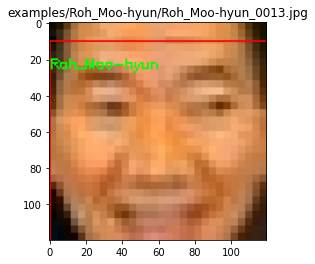

Detecting face  2  out of  90
[INFO] recognizing faces in  examples/Roh_Moo-hyun/Roh_Moo-hyun_0011.jpg
Correct face recognized


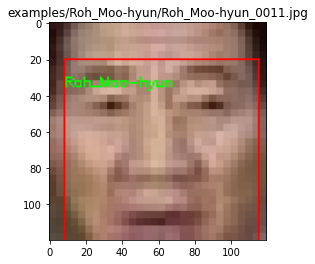

Detecting face  3  out of  90
[INFO] recognizing faces in  examples/Roh_Moo-hyun/Roh_Moo-hyun_0012.jpg
Correct face recognized


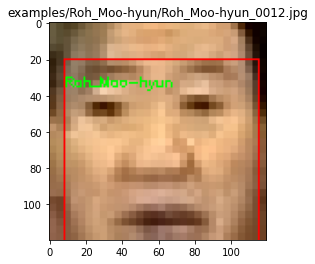

Detecting face  4  out of  90
[INFO] recognizing faces in  examples/Gloria_Macapagal_Arroyo/Gloria_Macapagal_Arroyo_0011.jpg
Folder name is:  ['Gloria_Macapagal_Arroyo'] . However, face detected is: []


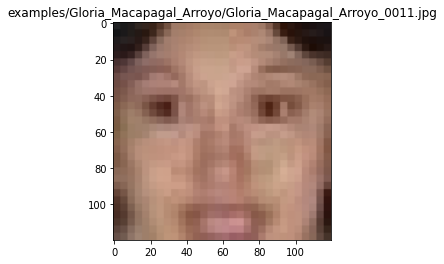

Detecting face  5  out of  90
[INFO] recognizing faces in  examples/Gloria_Macapagal_Arroyo/Gloria_Macapagal_Arroyo_0012.jpg
Correct face recognized


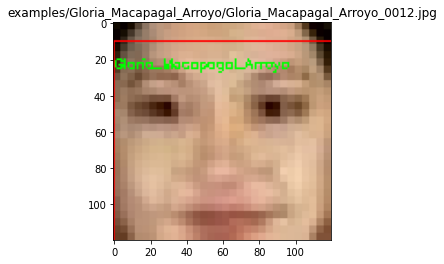

Detecting face  6  out of  90
[INFO] recognizing faces in  examples/Gloria_Macapagal_Arroyo/Gloria_Macapagal_Arroyo_0013.jpg
Folder name is:  ['Gloria_Macapagal_Arroyo'] . However, face detected is: ['Megawati_Sukarnoputri']


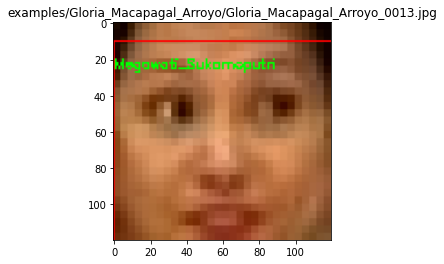

Detecting face  7  out of  90
[INFO] recognizing faces in  examples/Hans_Blix/Hans_Blix_0011.jpg
Correct face recognized


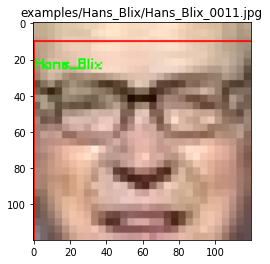

Detecting face  8  out of  90
[INFO] recognizing faces in  examples/Hans_Blix/Hans_Blix_0012.jpg
Correct face recognized


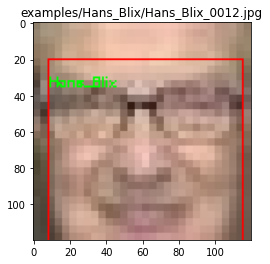

Detecting face  9  out of  90
[INFO] recognizing faces in  examples/Hans_Blix/Hans_Blix_0013.jpg
Correct face recognized


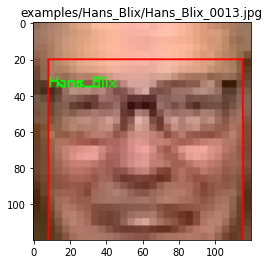

Detecting face  10  out of  90
[INFO] recognizing faces in  examples/Silvio_Berlusconi/Silvio_Berlusconi_0012.jpg
Correct face recognized


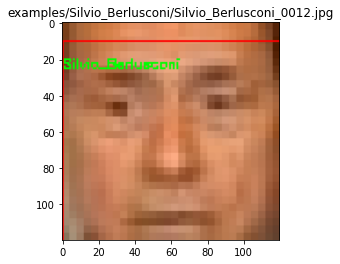

Detecting face  11  out of  90
[INFO] recognizing faces in  examples/Silvio_Berlusconi/Silvio_Berlusconi_0011.jpg
Correct face recognized


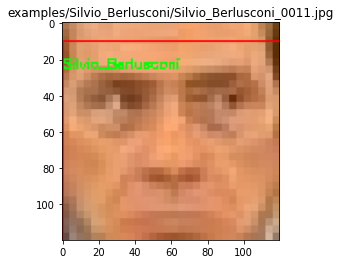

Detecting face  12  out of  90
[INFO] recognizing faces in  examples/Silvio_Berlusconi/Silvio_Berlusconi_0013.jpg
Correct face recognized


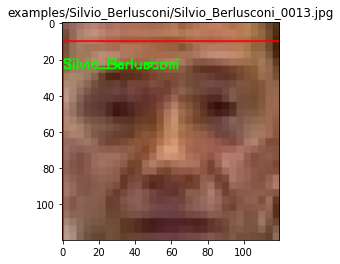

Detecting face  13  out of  90
[INFO] recognizing faces in  examples/Laura_Bush/Laura_Bush_0012.jpg
Correct face recognized


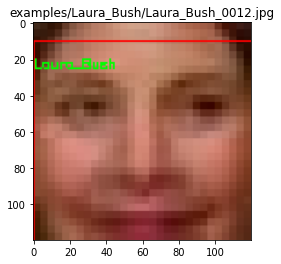

Detecting face  14  out of  90
[INFO] recognizing faces in  examples/Laura_Bush/Laura_Bush_0013.jpg
Correct face recognized


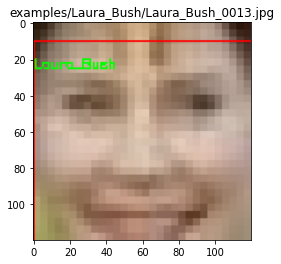

Detecting face  15  out of  90
[INFO] recognizing faces in  examples/Laura_Bush/Laura_Bush_0011.jpg
Correct face recognized


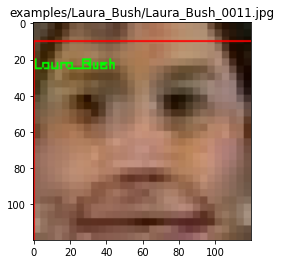

Detecting face  16  out of  90
[INFO] recognizing faces in  examples/John_Ashcroft/John_Ashcroft_0013.jpg
Correct face recognized


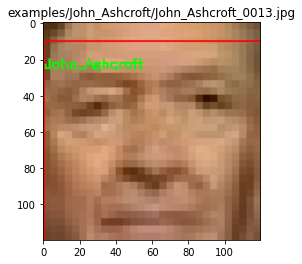

Detecting face  17  out of  90
[INFO] recognizing faces in  examples/John_Ashcroft/John_Ashcroft_0012.jpg
Correct face recognized


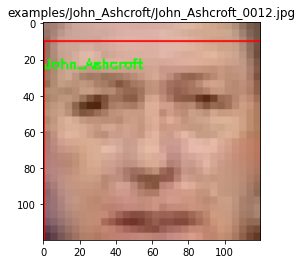

Detecting face  18  out of  90
[INFO] recognizing faces in  examples/John_Ashcroft/John_Ashcroft_0011.jpg
Correct face recognized


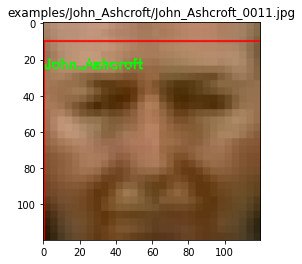

Detecting face  19  out of  90
[INFO] recognizing faces in  examples/Tom_Ridge/Tom_Ridge_0013.jpg
Correct face recognized


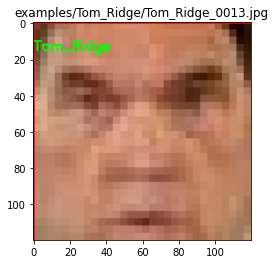

Detecting face  20  out of  90
[INFO] recognizing faces in  examples/Tom_Ridge/Tom_Ridge_0012.jpg
Correct face recognized


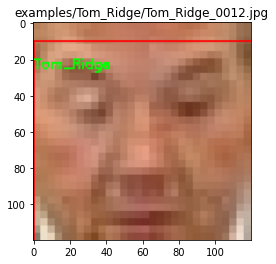

Detecting face  21  out of  90
[INFO] recognizing faces in  examples/Tom_Ridge/Tom_Ridge_0011.jpg
Correct face recognized


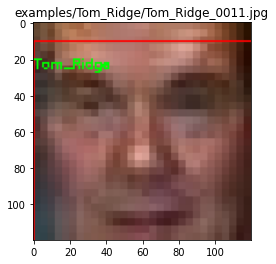

Detecting face  22  out of  90
[INFO] recognizing faces in  examples/Andre_Agassi/Andre_Agassi_0012.jpg
Correct face recognized


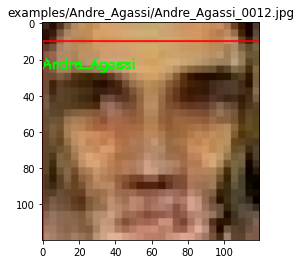

Detecting face  23  out of  90
[INFO] recognizing faces in  examples/Andre_Agassi/Andre_Agassi_0011.jpg
Correct face recognized


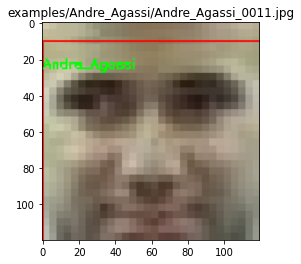

Detecting face  24  out of  90
[INFO] recognizing faces in  examples/Andre_Agassi/Andre_Agassi_0013.jpg
Correct face recognized


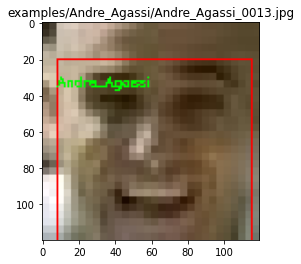

Detecting face  25  out of  90
[INFO] recognizing faces in  examples/Vicente_Fox/Vicente_Fox_0011.jpg
Correct face recognized


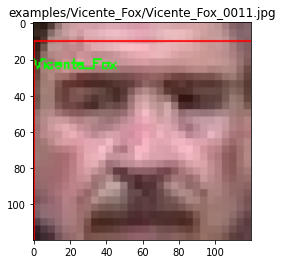

Detecting face  26  out of  90
[INFO] recognizing faces in  examples/Vicente_Fox/Vicente_Fox_0013.jpg
Correct face recognized


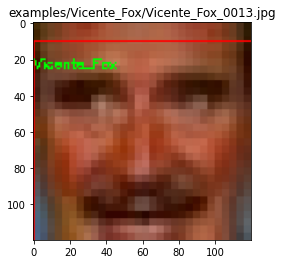

Detecting face  27  out of  90
[INFO] recognizing faces in  examples/Vicente_Fox/Vicente_Fox_0012.jpg
Correct face recognized


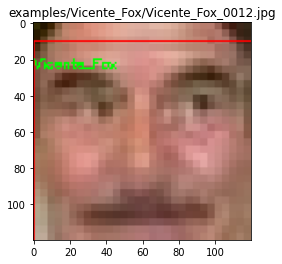

Detecting face  28  out of  90
[INFO] recognizing faces in  examples/Colin_Powell/Colin_Powell_0012.jpg
Correct face recognized


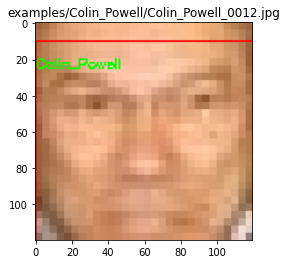

Detecting face  29  out of  90
[INFO] recognizing faces in  examples/Colin_Powell/Colin_Powell_0013.jpg
Correct face recognized


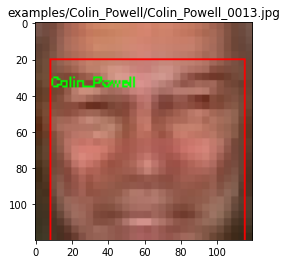

Detecting face  30  out of  90
[INFO] recognizing faces in  examples/Colin_Powell/Colin_Powell_0011.jpg
Correct face recognized


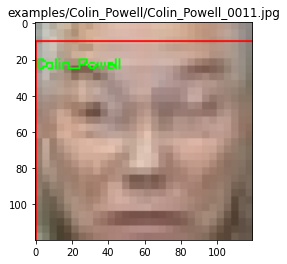

Detecting face  31  out of  90
[INFO] recognizing faces in  examples/Luiz_Inacio_Lula_da_Silva/Luiz_Inacio_Lula_da_Silva_0011.jpg
Correct face recognized


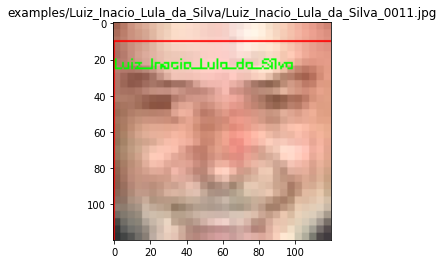

Detecting face  32  out of  90
[INFO] recognizing faces in  examples/Luiz_Inacio_Lula_da_Silva/Luiz_Inacio_Lula_da_Silva_0012.jpg
Correct face recognized


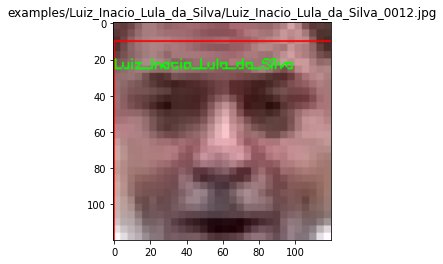

Detecting face  33  out of  90
[INFO] recognizing faces in  examples/Luiz_Inacio_Lula_da_Silva/Luiz_Inacio_Lula_da_Silva_0013.jpg
Folder name is:  ['Luiz_Inacio_Lula_da_Silva'] . However, face detected is: ['Hans_Blix']


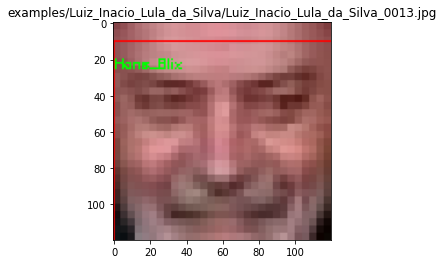

Detecting face  34  out of  90
[INFO] recognizing faces in  examples/Alejandro_Toledo/Alejandro_Toledo_0012.jpg
Correct face recognized


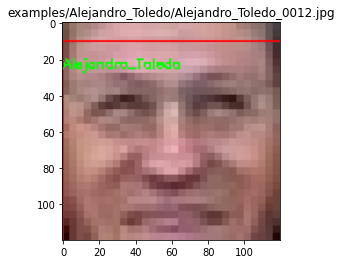

Detecting face  35  out of  90
[INFO] recognizing faces in  examples/Alejandro_Toledo/Alejandro_Toledo_0011.jpg
Correct face recognized


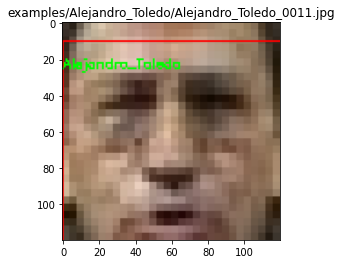

Detecting face  36  out of  90
[INFO] recognizing faces in  examples/Alejandro_Toledo/Alejandro_Toledo_0013.jpg
Correct face recognized


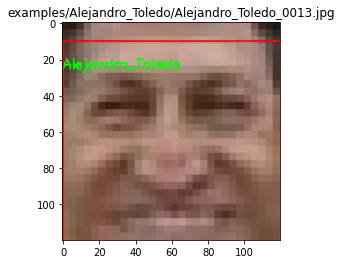

Detecting face  37  out of  90
[INFO] recognizing faces in  examples/Megawati_Sukarnoputri/Megawati_Sukarnoputri_0011.jpg
Correct face recognized


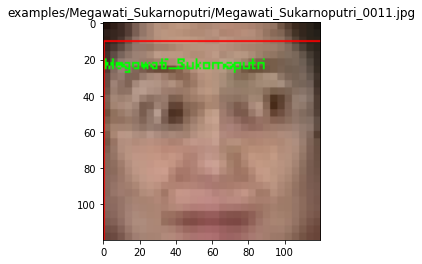

Detecting face  38  out of  90
[INFO] recognizing faces in  examples/Megawati_Sukarnoputri/Megawati_Sukarnoputri_0013.jpg
Correct face recognized


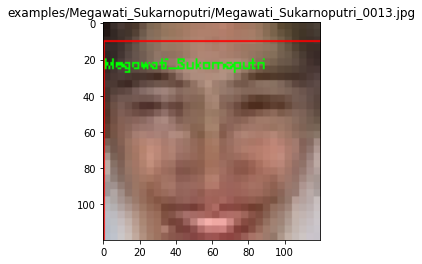

Detecting face  39  out of  90
[INFO] recognizing faces in  examples/Megawati_Sukarnoputri/Megawati_Sukarnoputri_0012.jpg
Correct face recognized


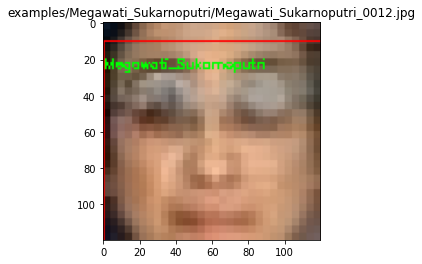

Detecting face  40  out of  90
[INFO] recognizing faces in  examples/Lleyton_Hewitt/Lleyton_Hewitt_0013.jpg
Correct face recognized


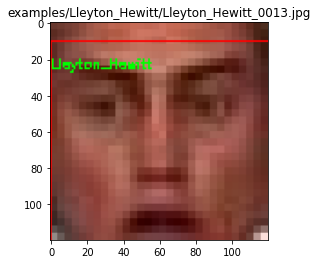

Detecting face  41  out of  90
[INFO] recognizing faces in  examples/Lleyton_Hewitt/Lleyton_Hewitt_0011.jpg
Correct face recognized


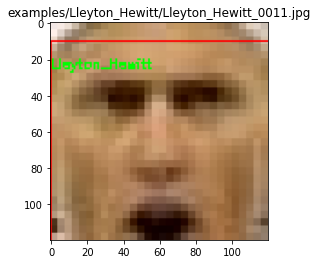

Detecting face  42  out of  90
[INFO] recognizing faces in  examples/Lleyton_Hewitt/Lleyton_Hewitt_0012.jpg
Correct face recognized


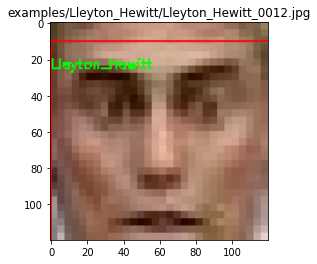

Detecting face  43  out of  90
[INFO] recognizing faces in  examples/Unknown/Aaron_Eckhart_A.jpg
Folder name is:  ['Unknown'] . However, face detected is: ['Silvio_Berlusconi']


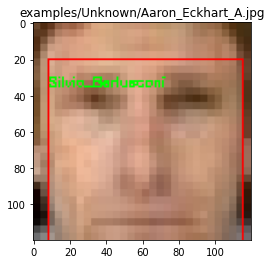

Detecting face  44  out of  90
[INFO] recognizing faces in  examples/Unknown/Aaron_Guiel_B.jpg
Folder name is:  ['Unknown'] . However, face detected is: []


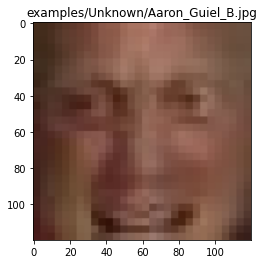

Detecting face  45  out of  90
[INFO] recognizing faces in  examples/Unknown/Adriana_Lima_C.jpg
Correct face recognized


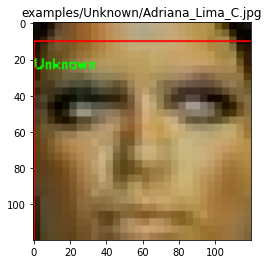

Detecting face  46  out of  90
[INFO] recognizing faces in  examples/George_W_Bush/George_W_Bush_0013.jpg
Correct face recognized


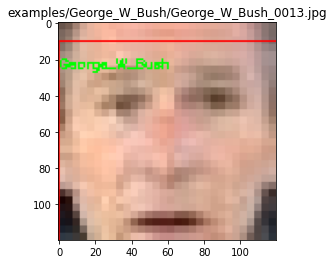

Detecting face  47  out of  90
[INFO] recognizing faces in  examples/George_W_Bush/George_W_Bush_0011.jpg
Correct face recognized


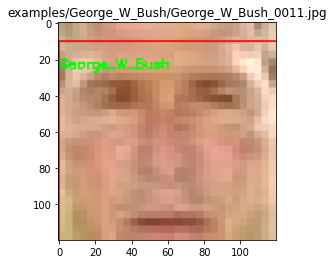

Detecting face  48  out of  90
[INFO] recognizing faces in  examples/George_W_Bush/George_W_Bush_0012.jpg
Correct face recognized


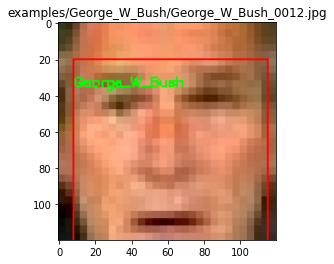

Detecting face  49  out of  90
[INFO] recognizing faces in  examples/Nestor_Kirchner/Nestor_Kirchner_0012.jpg
Correct face recognized


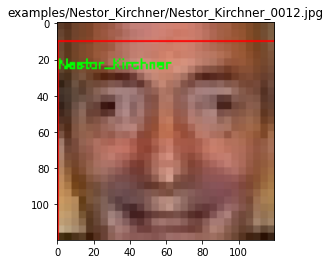

Detecting face  50  out of  90
[INFO] recognizing faces in  examples/Nestor_Kirchner/Nestor_Kirchner_0013.jpg
Correct face recognized


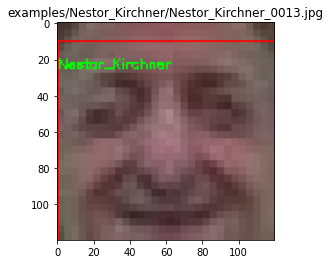

Detecting face  51  out of  90
[INFO] recognizing faces in  examples/Nestor_Kirchner/Nestor_Kirchner_0011.jpg
Correct face recognized


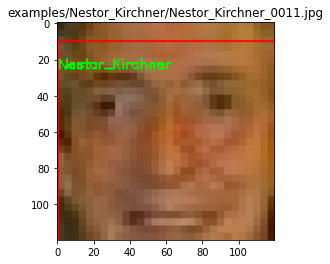

Detecting face  52  out of  90
[INFO] recognizing faces in  examples/Alvaro_Uribe/Alvaro_Uribe_0012.jpg
Correct face recognized


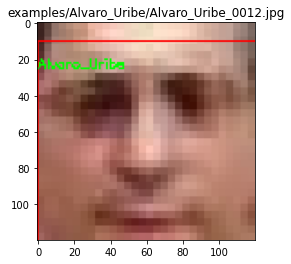

Detecting face  53  out of  90
[INFO] recognizing faces in  examples/Alvaro_Uribe/Alvaro_Uribe_0011.jpg
Correct face recognized


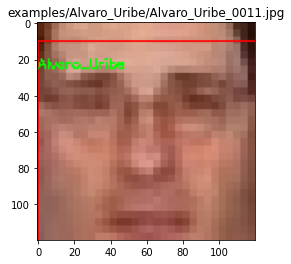

Detecting face  54  out of  90
[INFO] recognizing faces in  examples/Alvaro_Uribe/Alvaro_Uribe_0013.jpg
Correct face recognized


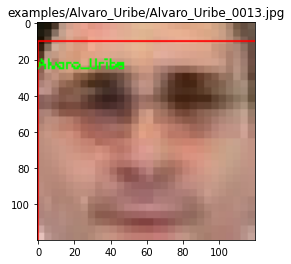

Detecting face  55  out of  90
[INFO] recognizing faces in  examples/Tony_Blair/Tony_Blair_0011.jpg
Correct face recognized


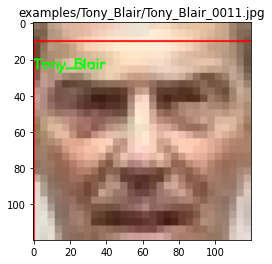

Detecting face  56  out of  90
[INFO] recognizing faces in  examples/Tony_Blair/Tony_Blair_0012.jpg
Correct face recognized


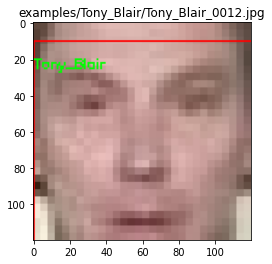

Detecting face  57  out of  90
[INFO] recognizing faces in  examples/Tony_Blair/Tony_Blair_0013.jpg
Correct face recognized


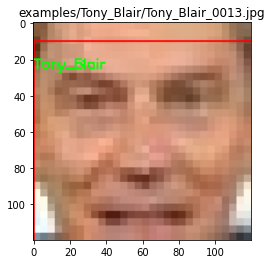

Detecting face  58  out of  90
[INFO] recognizing faces in  examples/Kofi_Annan/Kofi_Annan_0011.jpg
Correct face recognized


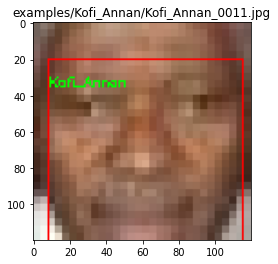

Detecting face  59  out of  90
[INFO] recognizing faces in  examples/Kofi_Annan/Kofi_Annan_0013.jpg
Correct face recognized


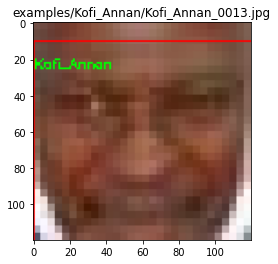

Detecting face  60  out of  90
[INFO] recognizing faces in  examples/Kofi_Annan/Kofi_Annan_0012.jpg
Correct face recognized


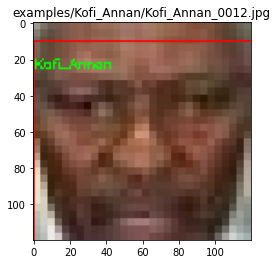

Detecting face  61  out of  90
[INFO] recognizing faces in  examples/Arnold_Schwarzenegger/Arnold_Schwarzenegger_0012.jpg
Correct face recognized


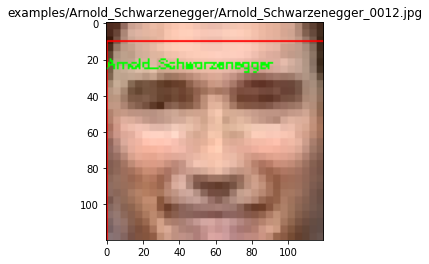

Detecting face  62  out of  90
[INFO] recognizing faces in  examples/Arnold_Schwarzenegger/Arnold_Schwarzenegger_0011.jpg
Folder name is:  ['Arnold_Schwarzenegger'] . However, face detected is: []


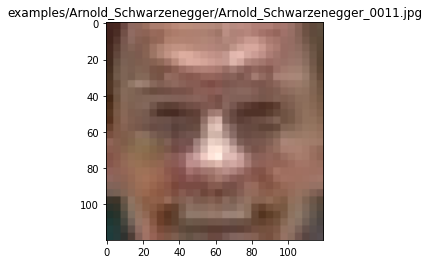

Detecting face  63  out of  90
[INFO] recognizing faces in  examples/Arnold_Schwarzenegger/Arnold_Schwarzenegger_0013.jpg
Folder name is:  ['Arnold_Schwarzenegger'] . However, face detected is: ['Alvaro_Uribe']


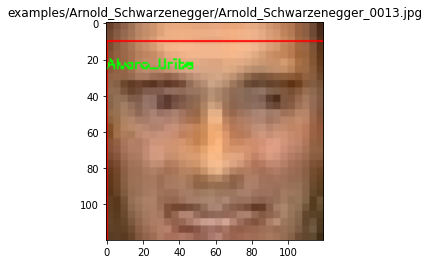

Detecting face  64  out of  90
[INFO] recognizing faces in  examples/Jacques_Chirac/Jacques_Chirac_0011.jpg
Correct face recognized


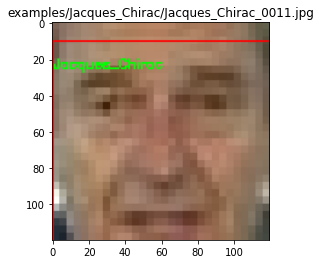

Detecting face  65  out of  90
[INFO] recognizing faces in  examples/Jacques_Chirac/Jacques_Chirac_0013.jpg
Folder name is:  ['Jacques_Chirac'] . However, face detected is: ['Alvaro_Uribe']


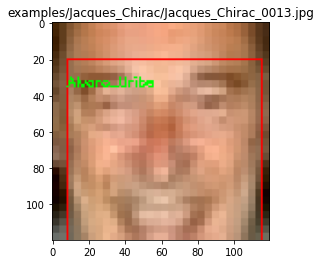

Detecting face  66  out of  90
[INFO] recognizing faces in  examples/Jacques_Chirac/Jacques_Chirac_0012.jpg
Correct face recognized


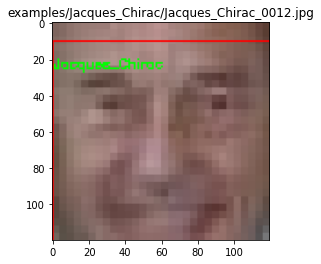

Detecting face  67  out of  90
[INFO] recognizing faces in  examples/Donald_Rumsfeld/Donald_Rumsfeld_0011.jpg
Correct face recognized


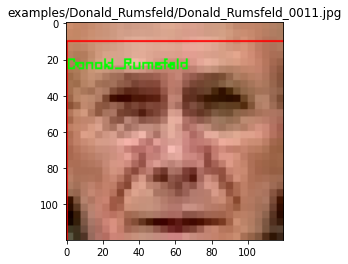

Detecting face  68  out of  90
[INFO] recognizing faces in  examples/Donald_Rumsfeld/Donald_Rumsfeld_0013.jpg
Correct face recognized


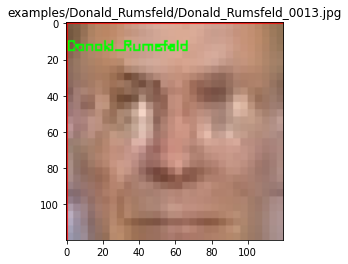

Detecting face  69  out of  90
[INFO] recognizing faces in  examples/Donald_Rumsfeld/Donald_Rumsfeld_0012.jpg
Correct face recognized


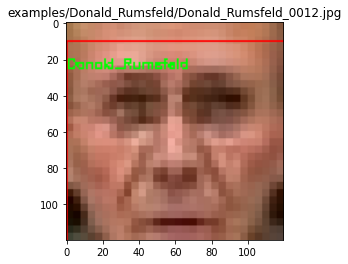

Detecting face  70  out of  90
[INFO] recognizing faces in  examples/Ariel_Sharon/Ariel_Sharon_0013.jpg
Correct face recognized


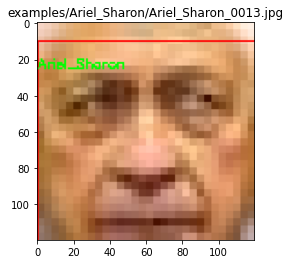

Detecting face  71  out of  90
[INFO] recognizing faces in  examples/Ariel_Sharon/Ariel_Sharon_0011.jpg
Correct face recognized


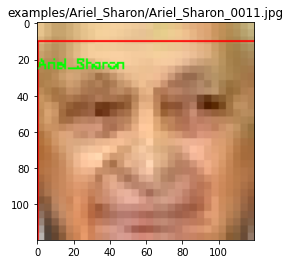

Detecting face  72  out of  90
[INFO] recognizing faces in  examples/Ariel_Sharon/Ariel_Sharon_0012.jpg
Correct face recognized


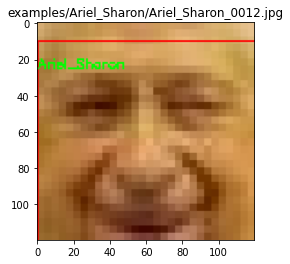

Detecting face  73  out of  90
[INFO] recognizing faces in  examples/Hugo_Chavez/Hugo_Chavez_0011.jpg
Correct face recognized


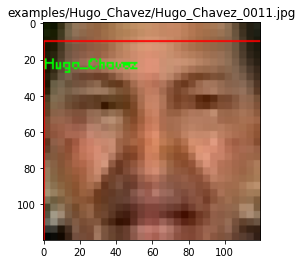

Detecting face  74  out of  90
[INFO] recognizing faces in  examples/Hugo_Chavez/Hugo_Chavez_0012.jpg
Correct face recognized


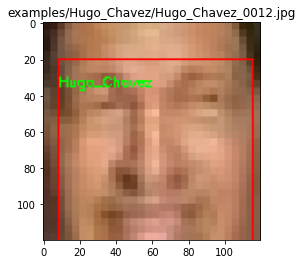

Detecting face  75  out of  90
[INFO] recognizing faces in  examples/Hugo_Chavez/Hugo_Chavez_0013.jpg
Correct face recognized


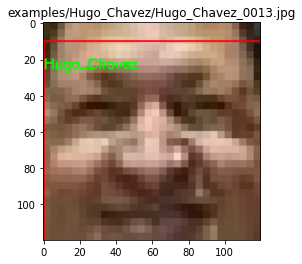

Detecting face  76  out of  90
[INFO] recognizing faces in  examples/Serena_Williams/Serena_Williams_0013.jpg
Correct face recognized


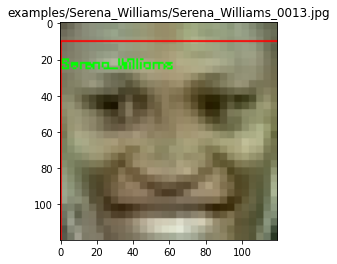

Detecting face  77  out of  90
[INFO] recognizing faces in  examples/Serena_Williams/Serena_Williams_0011.jpg
Folder name is:  ['Serena_Williams'] . However, face detected is: []


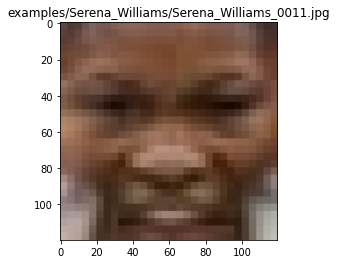

Detecting face  78  out of  90
[INFO] recognizing faces in  examples/Serena_Williams/Serena_Williams_0012.jpg
Folder name is:  ['Serena_Williams'] . However, face detected is: []


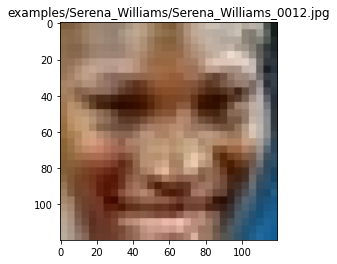

Detecting face  79  out of  90
[INFO] recognizing faces in  examples/Jean_Chretien/Jean_Chretien_0013.jpg
Folder name is:  ['Jean_Chretien'] . However, face detected is: ['Ariel_Sharon']


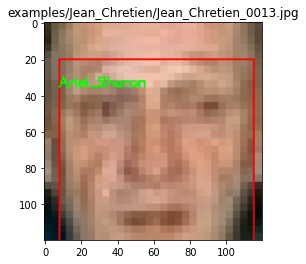

Detecting face  80  out of  90
[INFO] recognizing faces in  examples/Jean_Chretien/Jean_Chretien_0011.jpg
Correct face recognized


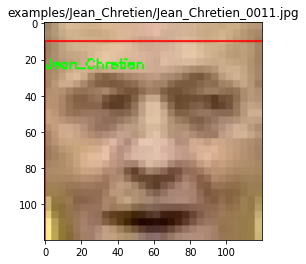

Detecting face  81  out of  90
[INFO] recognizing faces in  examples/Jean_Chretien/Jean_Chretien_0012.jpg
Correct face recognized


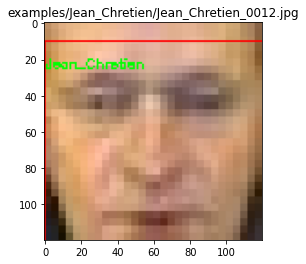

Detecting face  82  out of  90
[INFO] recognizing faces in  examples/Gerhard_Schroeder/Gerhard_Schroeder_0012.jpg
Correct face recognized


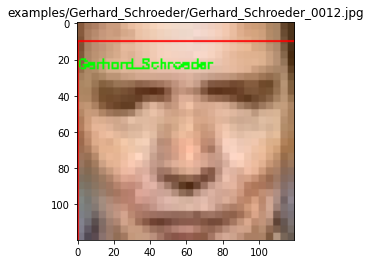

Detecting face  83  out of  90
[INFO] recognizing faces in  examples/Gerhard_Schroeder/Gerhard_Schroeder_0013.jpg
Correct face recognized


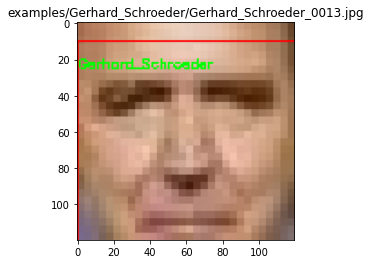

Detecting face  84  out of  90
[INFO] recognizing faces in  examples/Gerhard_Schroeder/Gerhard_Schroeder_0011.jpg
Correct face recognized


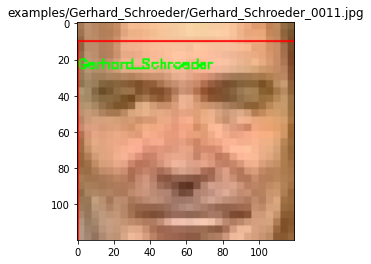

Detecting face  85  out of  90
[INFO] recognizing faces in  examples/Junichiro_Koizumi/Junichiro_Koizumi_0011.jpg
Correct face recognized


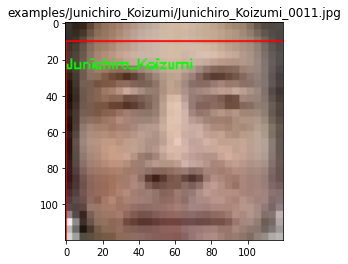

Detecting face  86  out of  90
[INFO] recognizing faces in  examples/Junichiro_Koizumi/Junichiro_Koizumi_0013.jpg
Correct face recognized


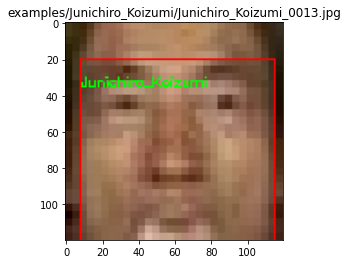

Detecting face  87  out of  90
[INFO] recognizing faces in  examples/Junichiro_Koizumi/Junichiro_Koizumi_0012.jpg
Correct face recognized


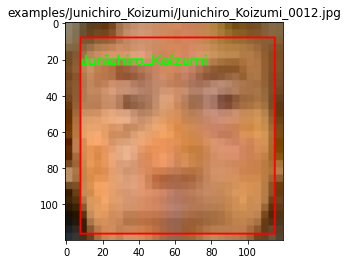

Detecting face  88  out of  90
[INFO] recognizing faces in  examples/Jennifer_Capriati/Jennifer_Capriati_0013.jpg
Correct face recognized


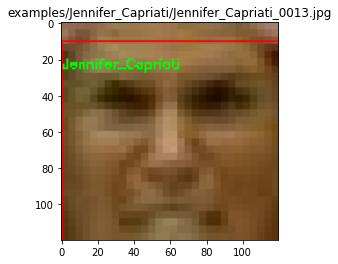

Detecting face  89  out of  90
[INFO] recognizing faces in  examples/Jennifer_Capriati/Jennifer_Capriati_0011.jpg
Folder name is:  ['Jennifer_Capriati'] . However, face detected is: ['Colin_Powell']


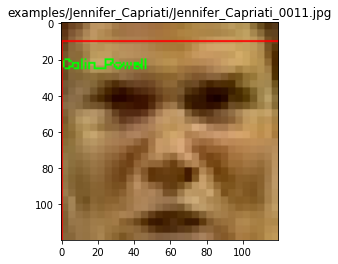

Detecting face  90  out of  90
[INFO] recognizing faces in  examples/Jennifer_Capriati/Jennifer_Capriati_0012.jpg
Correct face recognized


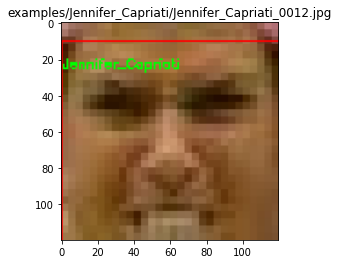

Summary
Total pictures 90
Faces identified correctly:  78
Faces identified wrongly:  7
Faces not identified:  5
Absolute Accuracy (correct / [correct + incorrect + not detected]) * 100%: 
87.0 %
Detection Accuracy [(correct + incorrect) / total] * 100%: 
94.44 %
END, time taken:  60.92 seconds
Avg. secs. per picture:  0.68 seconds


In [17]:
print("Face identification: Direct using nearest neighbour")
print("=========================================================")
recognize_face("direct", "examples")

Face identification: Scalin with bicubic
[INFO] loading encodings...
Detecting face  1  out of  90
[INFO] recognizing faces in  examples/Roh_Moo-hyun/Roh_Moo-hyun_0013.jpg
Correct face recognized


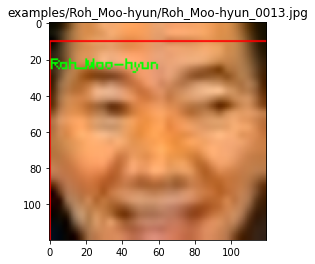

Detecting face  2  out of  90
[INFO] recognizing faces in  examples/Roh_Moo-hyun/Roh_Moo-hyun_0011.jpg
Correct face recognized


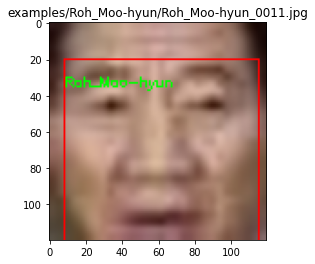

Detecting face  3  out of  90
[INFO] recognizing faces in  examples/Roh_Moo-hyun/Roh_Moo-hyun_0012.jpg
Correct face recognized


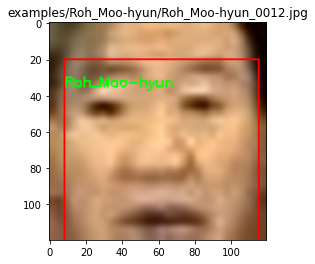

Detecting face  4  out of  90
[INFO] recognizing faces in  examples/Gloria_Macapagal_Arroyo/Gloria_Macapagal_Arroyo_0011.jpg
Correct face recognized


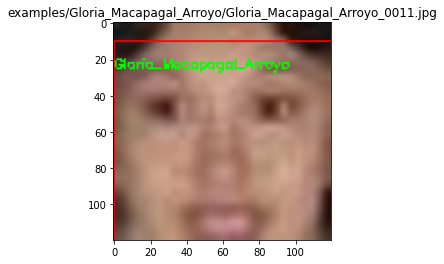

Detecting face  5  out of  90
[INFO] recognizing faces in  examples/Gloria_Macapagal_Arroyo/Gloria_Macapagal_Arroyo_0012.jpg
Correct face recognized


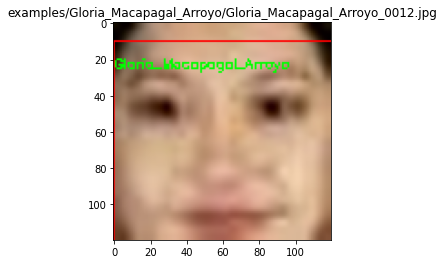

Detecting face  6  out of  90
[INFO] recognizing faces in  examples/Gloria_Macapagal_Arroyo/Gloria_Macapagal_Arroyo_0013.jpg
Folder name is:  ['Gloria_Macapagal_Arroyo'] . However, face detected is: ['Megawati_Sukarnoputri']


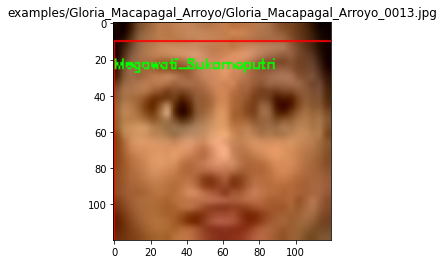

Detecting face  7  out of  90
[INFO] recognizing faces in  examples/Hans_Blix/Hans_Blix_0011.jpg
Correct face recognized


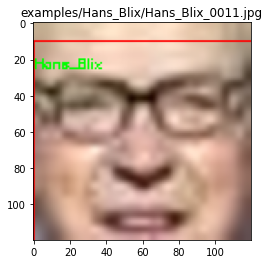

Detecting face  8  out of  90
[INFO] recognizing faces in  examples/Hans_Blix/Hans_Blix_0012.jpg
Correct face recognized


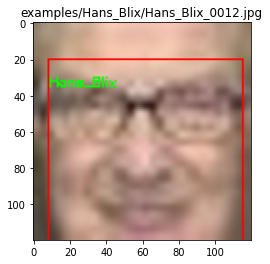

Detecting face  9  out of  90
[INFO] recognizing faces in  examples/Hans_Blix/Hans_Blix_0013.jpg
Correct face recognized


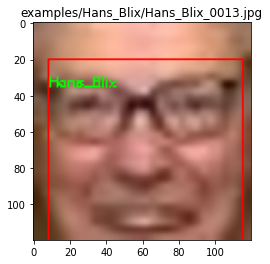

Detecting face  10  out of  90
[INFO] recognizing faces in  examples/Silvio_Berlusconi/Silvio_Berlusconi_0012.jpg
Correct face recognized


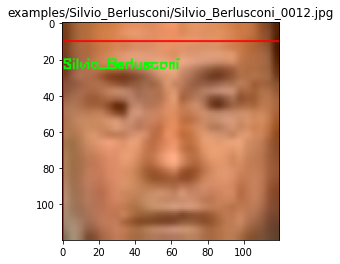

Detecting face  11  out of  90
[INFO] recognizing faces in  examples/Silvio_Berlusconi/Silvio_Berlusconi_0011.jpg
Correct face recognized


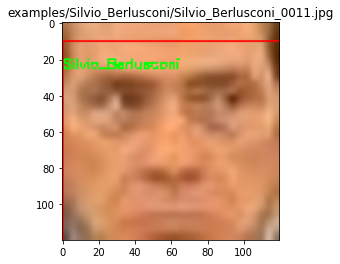

Detecting face  12  out of  90
[INFO] recognizing faces in  examples/Silvio_Berlusconi/Silvio_Berlusconi_0013.jpg
Correct face recognized


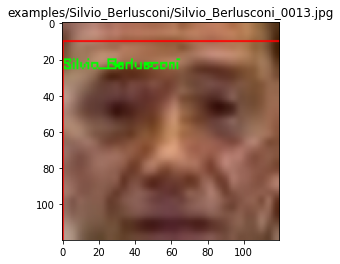

Detecting face  13  out of  90
[INFO] recognizing faces in  examples/Laura_Bush/Laura_Bush_0012.jpg
Correct face recognized


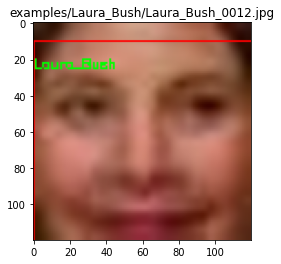

Detecting face  14  out of  90
[INFO] recognizing faces in  examples/Laura_Bush/Laura_Bush_0013.jpg
Correct face recognized


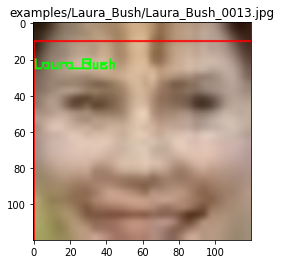

Detecting face  15  out of  90
[INFO] recognizing faces in  examples/Laura_Bush/Laura_Bush_0011.jpg
Folder name is:  ['Laura_Bush'] . However, face detected is: []


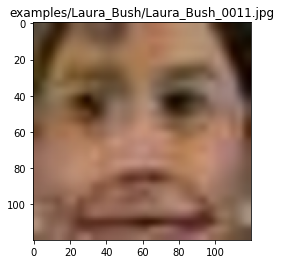

Detecting face  16  out of  90
[INFO] recognizing faces in  examples/John_Ashcroft/John_Ashcroft_0013.jpg
Correct face recognized


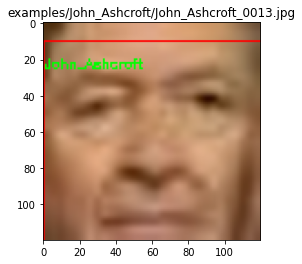

Detecting face  17  out of  90
[INFO] recognizing faces in  examples/John_Ashcroft/John_Ashcroft_0012.jpg
Correct face recognized


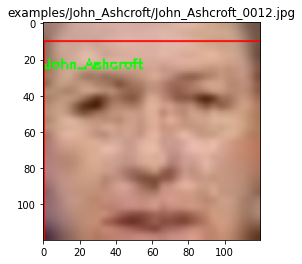

Detecting face  18  out of  90
[INFO] recognizing faces in  examples/John_Ashcroft/John_Ashcroft_0011.jpg
Correct face recognized


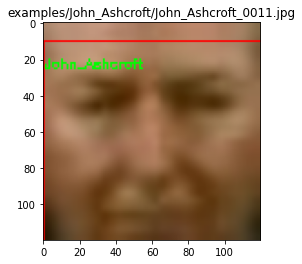

Detecting face  19  out of  90
[INFO] recognizing faces in  examples/Tom_Ridge/Tom_Ridge_0013.jpg
Correct face recognized


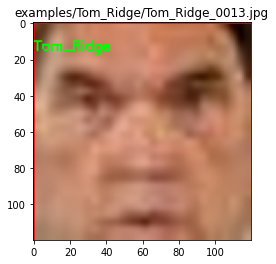

Detecting face  20  out of  90
[INFO] recognizing faces in  examples/Tom_Ridge/Tom_Ridge_0012.jpg
Correct face recognized


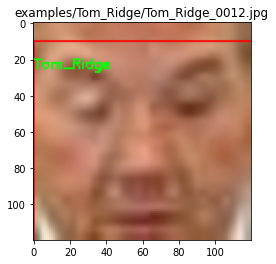

Detecting face  21  out of  90
[INFO] recognizing faces in  examples/Tom_Ridge/Tom_Ridge_0011.jpg
Correct face recognized


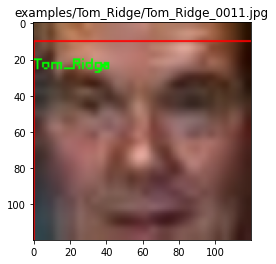

Detecting face  22  out of  90
[INFO] recognizing faces in  examples/Andre_Agassi/Andre_Agassi_0012.jpg
Correct face recognized


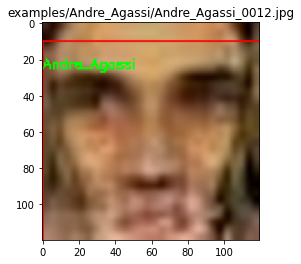

Detecting face  23  out of  90
[INFO] recognizing faces in  examples/Andre_Agassi/Andre_Agassi_0011.jpg
Correct face recognized


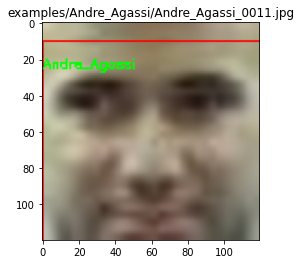

Detecting face  24  out of  90
[INFO] recognizing faces in  examples/Andre_Agassi/Andre_Agassi_0013.jpg
Correct face recognized


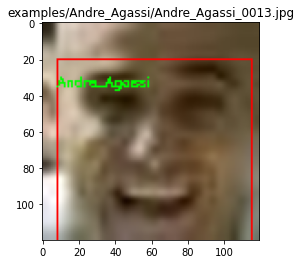

Detecting face  25  out of  90
[INFO] recognizing faces in  examples/Vicente_Fox/Vicente_Fox_0011.jpg
Correct face recognized


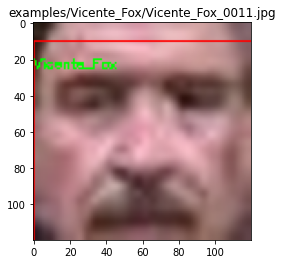

Detecting face  26  out of  90
[INFO] recognizing faces in  examples/Vicente_Fox/Vicente_Fox_0013.jpg
Correct face recognized


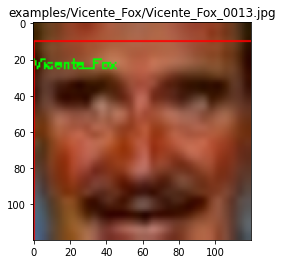

Detecting face  27  out of  90
[INFO] recognizing faces in  examples/Vicente_Fox/Vicente_Fox_0012.jpg
Correct face recognized


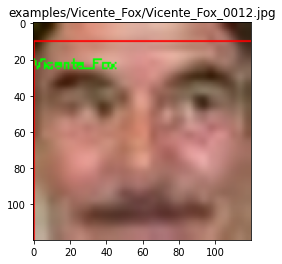

Detecting face  28  out of  90
[INFO] recognizing faces in  examples/Colin_Powell/Colin_Powell_0012.jpg
Correct face recognized


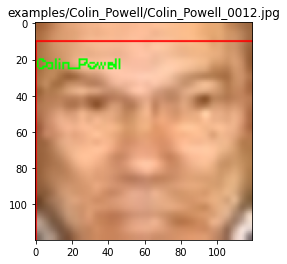

Detecting face  29  out of  90
[INFO] recognizing faces in  examples/Colin_Powell/Colin_Powell_0013.jpg
Correct face recognized


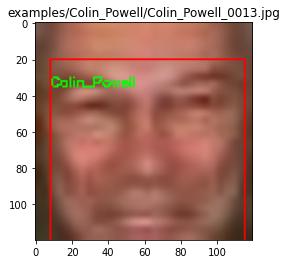

Detecting face  30  out of  90
[INFO] recognizing faces in  examples/Colin_Powell/Colin_Powell_0011.jpg
Correct face recognized


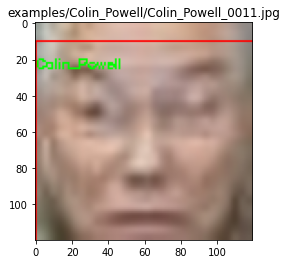

Detecting face  31  out of  90
[INFO] recognizing faces in  examples/Luiz_Inacio_Lula_da_Silva/Luiz_Inacio_Lula_da_Silva_0011.jpg
Correct face recognized


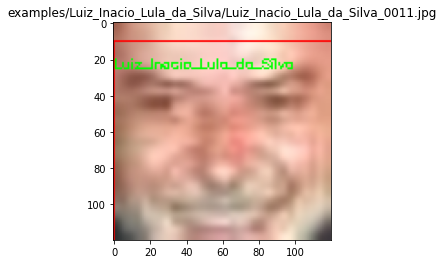

Detecting face  32  out of  90
[INFO] recognizing faces in  examples/Luiz_Inacio_Lula_da_Silva/Luiz_Inacio_Lula_da_Silva_0012.jpg
Correct face recognized


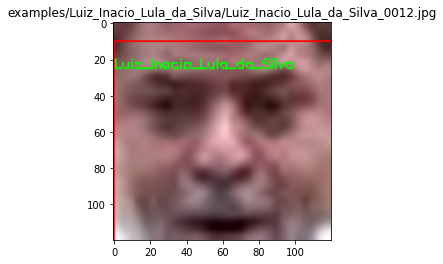

Detecting face  33  out of  90
[INFO] recognizing faces in  examples/Luiz_Inacio_Lula_da_Silva/Luiz_Inacio_Lula_da_Silva_0013.jpg
Correct face recognized


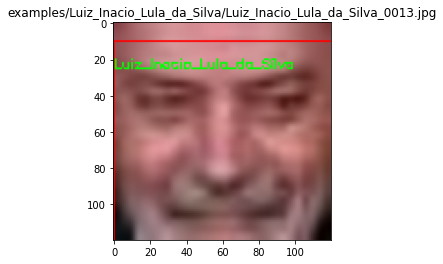

Detecting face  34  out of  90
[INFO] recognizing faces in  examples/Alejandro_Toledo/Alejandro_Toledo_0012.jpg
Correct face recognized


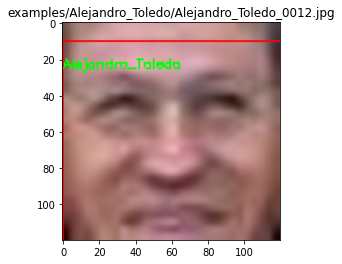

Detecting face  35  out of  90
[INFO] recognizing faces in  examples/Alejandro_Toledo/Alejandro_Toledo_0011.jpg
Correct face recognized


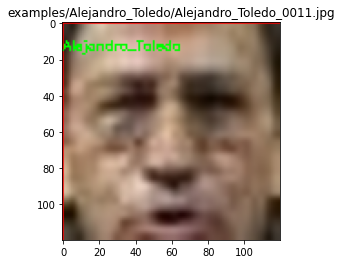

Detecting face  36  out of  90
[INFO] recognizing faces in  examples/Alejandro_Toledo/Alejandro_Toledo_0013.jpg
Folder name is:  ['Alejandro_Toledo'] . However, face detected is: ['Hugo_Chavez']


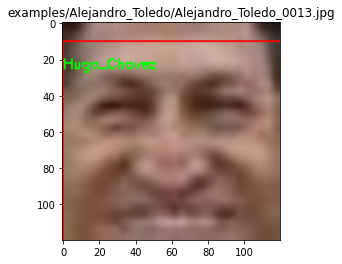

Detecting face  37  out of  90
[INFO] recognizing faces in  examples/Megawati_Sukarnoputri/Megawati_Sukarnoputri_0011.jpg
Correct face recognized


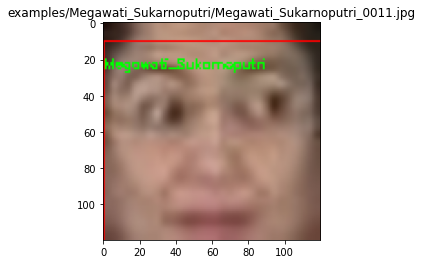

Detecting face  38  out of  90
[INFO] recognizing faces in  examples/Megawati_Sukarnoputri/Megawati_Sukarnoputri_0013.jpg
Correct face recognized


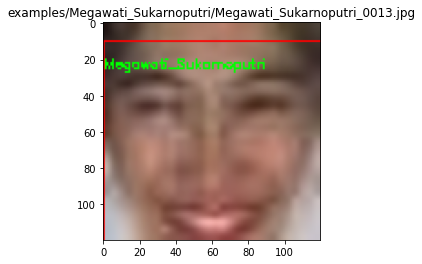

Detecting face  39  out of  90
[INFO] recognizing faces in  examples/Megawati_Sukarnoputri/Megawati_Sukarnoputri_0012.jpg
Correct face recognized


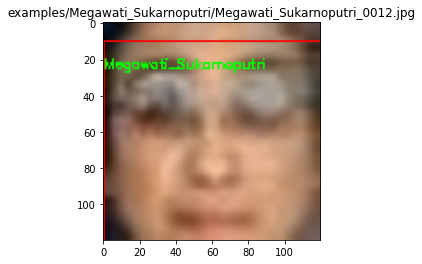

Detecting face  40  out of  90
[INFO] recognizing faces in  examples/Lleyton_Hewitt/Lleyton_Hewitt_0013.jpg
Correct face recognized


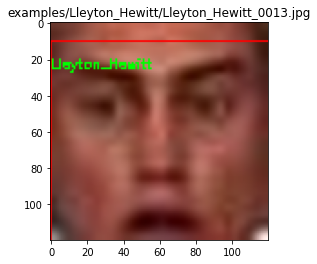

Detecting face  41  out of  90
[INFO] recognizing faces in  examples/Lleyton_Hewitt/Lleyton_Hewitt_0011.jpg
Correct face recognized


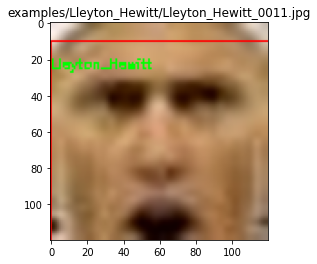

Detecting face  42  out of  90
[INFO] recognizing faces in  examples/Lleyton_Hewitt/Lleyton_Hewitt_0012.jpg
Correct face recognized


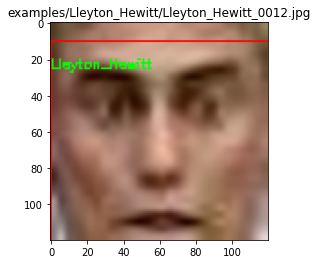

Detecting face  43  out of  90
[INFO] recognizing faces in  examples/Unknown/Aaron_Eckhart_A.jpg
Folder name is:  ['Unknown'] . However, face detected is: ['Silvio_Berlusconi']


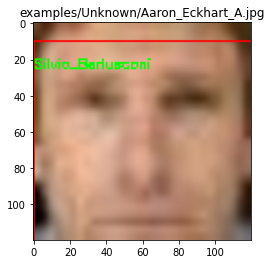

Detecting face  44  out of  90
[INFO] recognizing faces in  examples/Unknown/Aaron_Guiel_B.jpg
Folder name is:  ['Unknown'] . However, face detected is: []


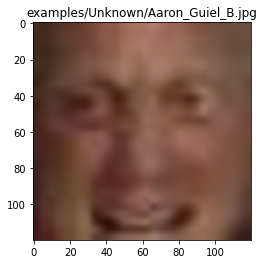

Detecting face  45  out of  90
[INFO] recognizing faces in  examples/Unknown/Adriana_Lima_C.jpg
Correct face recognized


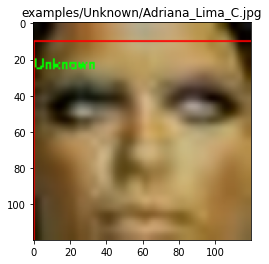

Detecting face  46  out of  90
[INFO] recognizing faces in  examples/George_W_Bush/George_W_Bush_0013.jpg
Correct face recognized


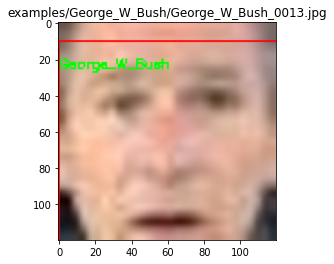

Detecting face  47  out of  90
[INFO] recognizing faces in  examples/George_W_Bush/George_W_Bush_0011.jpg
Correct face recognized


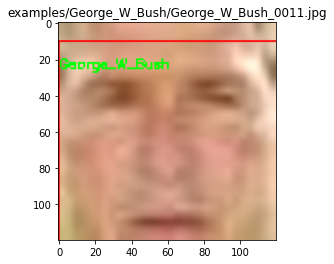

Detecting face  48  out of  90
[INFO] recognizing faces in  examples/George_W_Bush/George_W_Bush_0012.jpg
Correct face recognized


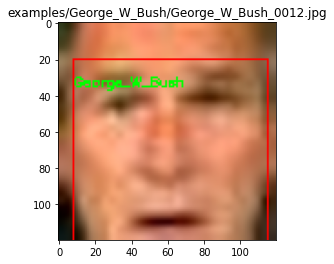

Detecting face  49  out of  90
[INFO] recognizing faces in  examples/Nestor_Kirchner/Nestor_Kirchner_0012.jpg
Correct face recognized


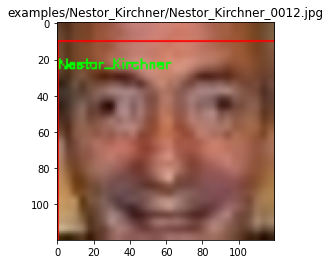

Detecting face  50  out of  90
[INFO] recognizing faces in  examples/Nestor_Kirchner/Nestor_Kirchner_0013.jpg
Correct face recognized


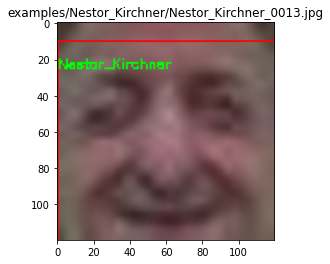

Detecting face  51  out of  90
[INFO] recognizing faces in  examples/Nestor_Kirchner/Nestor_Kirchner_0011.jpg
Correct face recognized


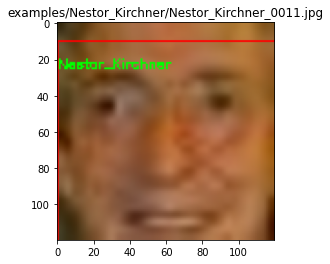

Detecting face  52  out of  90
[INFO] recognizing faces in  examples/Alvaro_Uribe/Alvaro_Uribe_0012.jpg
Correct face recognized


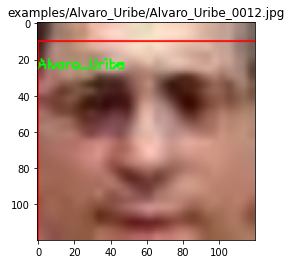

Detecting face  53  out of  90
[INFO] recognizing faces in  examples/Alvaro_Uribe/Alvaro_Uribe_0011.jpg
Correct face recognized


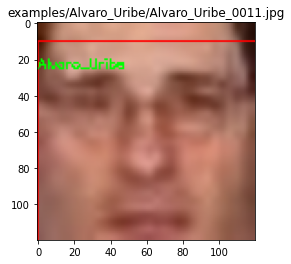

Detecting face  54  out of  90
[INFO] recognizing faces in  examples/Alvaro_Uribe/Alvaro_Uribe_0013.jpg
Correct face recognized


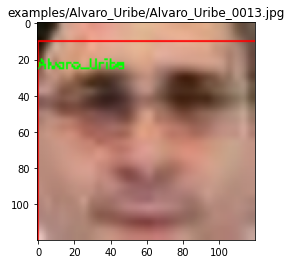

Detecting face  55  out of  90
[INFO] recognizing faces in  examples/Tony_Blair/Tony_Blair_0011.jpg
Correct face recognized


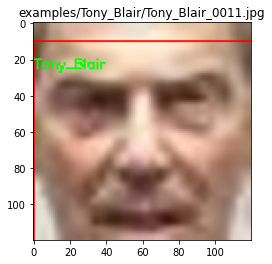

Detecting face  56  out of  90
[INFO] recognizing faces in  examples/Tony_Blair/Tony_Blair_0012.jpg
Correct face recognized


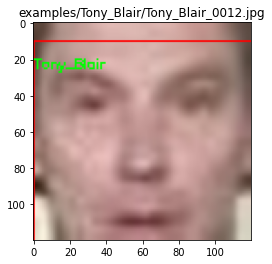

Detecting face  57  out of  90
[INFO] recognizing faces in  examples/Tony_Blair/Tony_Blair_0013.jpg
Correct face recognized


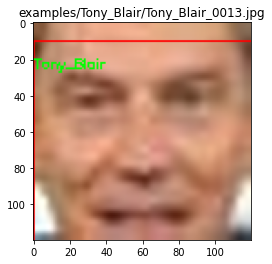

Detecting face  58  out of  90
[INFO] recognizing faces in  examples/Kofi_Annan/Kofi_Annan_0011.jpg
Correct face recognized


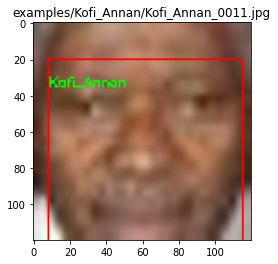

Detecting face  59  out of  90
[INFO] recognizing faces in  examples/Kofi_Annan/Kofi_Annan_0013.jpg
Correct face recognized


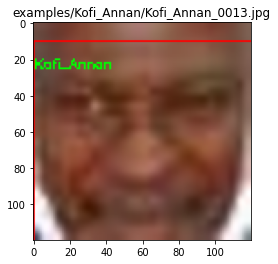

Detecting face  60  out of  90
[INFO] recognizing faces in  examples/Kofi_Annan/Kofi_Annan_0012.jpg
Correct face recognized


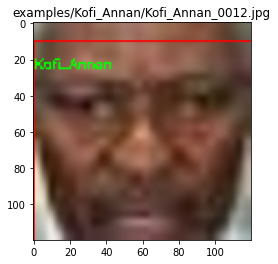

Detecting face  61  out of  90
[INFO] recognizing faces in  examples/Arnold_Schwarzenegger/Arnold_Schwarzenegger_0012.jpg
Correct face recognized


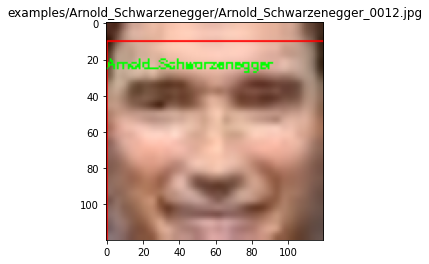

Detecting face  62  out of  90
[INFO] recognizing faces in  examples/Arnold_Schwarzenegger/Arnold_Schwarzenegger_0011.jpg
Folder name is:  ['Arnold_Schwarzenegger'] . However, face detected is: []


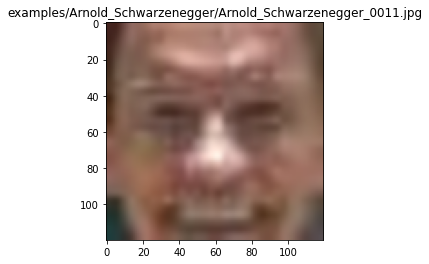

Detecting face  63  out of  90
[INFO] recognizing faces in  examples/Arnold_Schwarzenegger/Arnold_Schwarzenegger_0013.jpg
Folder name is:  ['Arnold_Schwarzenegger'] . However, face detected is: ['Alvaro_Uribe']


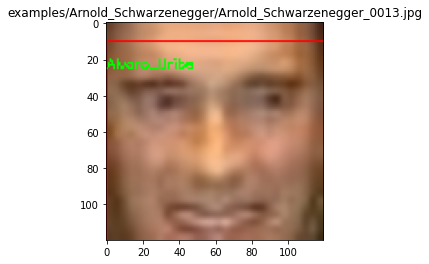

Detecting face  64  out of  90
[INFO] recognizing faces in  examples/Jacques_Chirac/Jacques_Chirac_0011.jpg
Correct face recognized


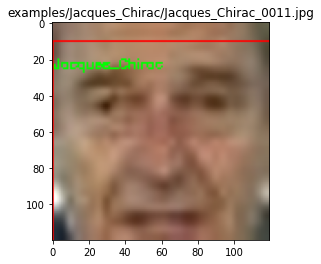

Detecting face  65  out of  90
[INFO] recognizing faces in  examples/Jacques_Chirac/Jacques_Chirac_0013.jpg
Correct face recognized


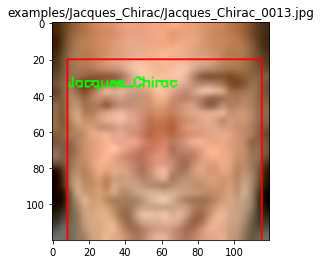

Detecting face  66  out of  90
[INFO] recognizing faces in  examples/Jacques_Chirac/Jacques_Chirac_0012.jpg
Correct face recognized


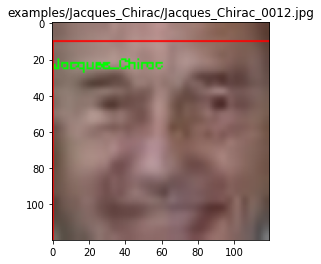

Detecting face  67  out of  90
[INFO] recognizing faces in  examples/Donald_Rumsfeld/Donald_Rumsfeld_0011.jpg
Correct face recognized


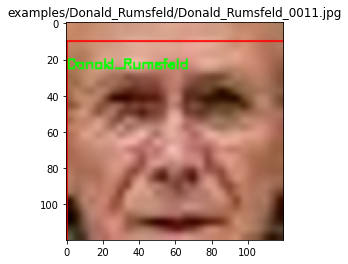

Detecting face  68  out of  90
[INFO] recognizing faces in  examples/Donald_Rumsfeld/Donald_Rumsfeld_0013.jpg
Folder name is:  ['Donald_Rumsfeld'] . However, face detected is: ['Silvio_Berlusconi']


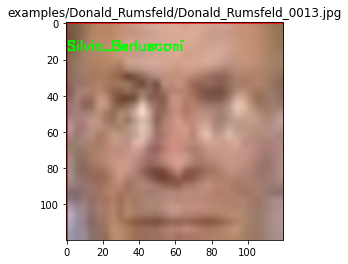

Detecting face  69  out of  90
[INFO] recognizing faces in  examples/Donald_Rumsfeld/Donald_Rumsfeld_0012.jpg
Correct face recognized


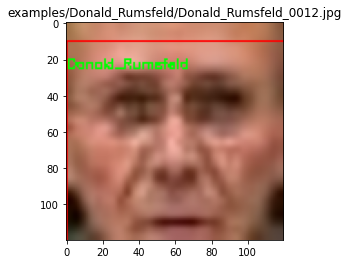

Detecting face  70  out of  90
[INFO] recognizing faces in  examples/Ariel_Sharon/Ariel_Sharon_0013.jpg
Correct face recognized


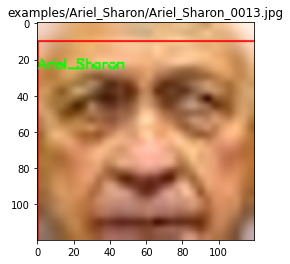

Detecting face  71  out of  90
[INFO] recognizing faces in  examples/Ariel_Sharon/Ariel_Sharon_0011.jpg
Correct face recognized


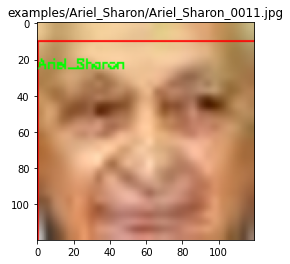

Detecting face  72  out of  90
[INFO] recognizing faces in  examples/Ariel_Sharon/Ariel_Sharon_0012.jpg
Correct face recognized


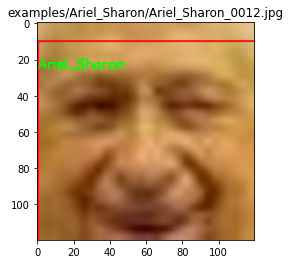

Detecting face  73  out of  90
[INFO] recognizing faces in  examples/Hugo_Chavez/Hugo_Chavez_0011.jpg
Correct face recognized


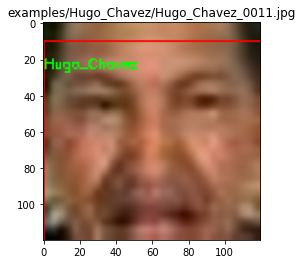

Detecting face  74  out of  90
[INFO] recognizing faces in  examples/Hugo_Chavez/Hugo_Chavez_0012.jpg
Correct face recognized


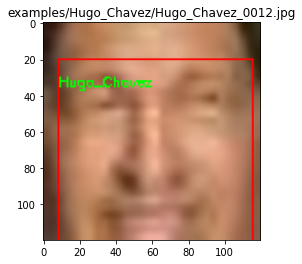

Detecting face  75  out of  90
[INFO] recognizing faces in  examples/Hugo_Chavez/Hugo_Chavez_0013.jpg
Correct face recognized


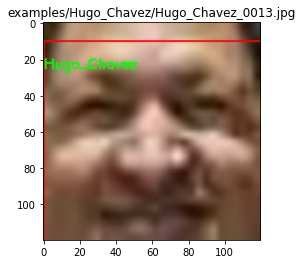

Detecting face  76  out of  90
[INFO] recognizing faces in  examples/Serena_Williams/Serena_Williams_0013.jpg
Correct face recognized


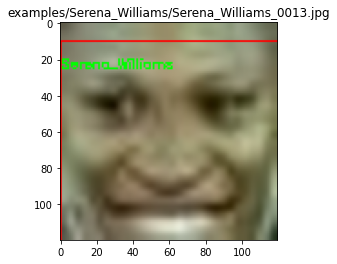

Detecting face  77  out of  90
[INFO] recognizing faces in  examples/Serena_Williams/Serena_Williams_0011.jpg
Folder name is:  ['Serena_Williams'] . However, face detected is: []


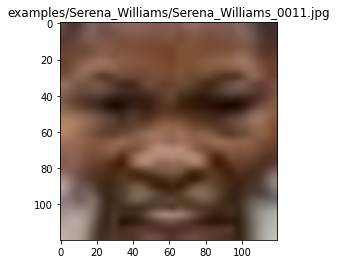

Detecting face  78  out of  90
[INFO] recognizing faces in  examples/Serena_Williams/Serena_Williams_0012.jpg
Folder name is:  ['Serena_Williams'] . However, face detected is: []


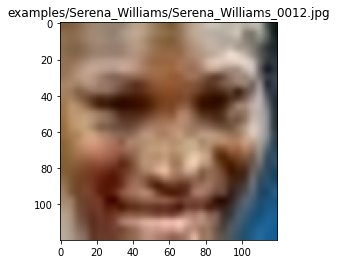

Detecting face  79  out of  90
[INFO] recognizing faces in  examples/Jean_Chretien/Jean_Chretien_0013.jpg
Folder name is:  ['Jean_Chretien'] . However, face detected is: ['Ariel_Sharon']


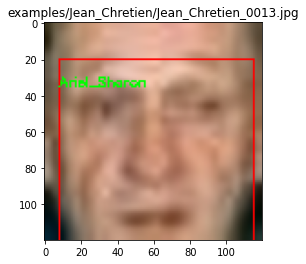

Detecting face  80  out of  90
[INFO] recognizing faces in  examples/Jean_Chretien/Jean_Chretien_0011.jpg
Correct face recognized


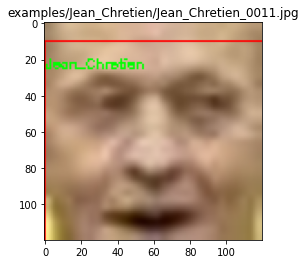

Detecting face  81  out of  90
[INFO] recognizing faces in  examples/Jean_Chretien/Jean_Chretien_0012.jpg
Correct face recognized


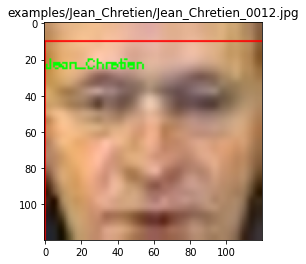

Detecting face  82  out of  90
[INFO] recognizing faces in  examples/Gerhard_Schroeder/Gerhard_Schroeder_0012.jpg
Correct face recognized


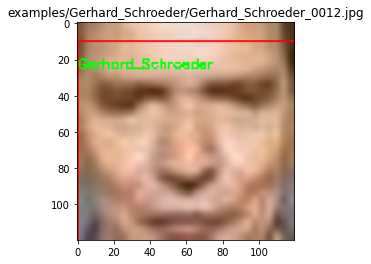

Detecting face  83  out of  90
[INFO] recognizing faces in  examples/Gerhard_Schroeder/Gerhard_Schroeder_0013.jpg
Correct face recognized


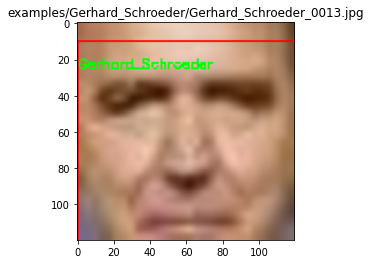

Detecting face  84  out of  90
[INFO] recognizing faces in  examples/Gerhard_Schroeder/Gerhard_Schroeder_0011.jpg
Correct face recognized


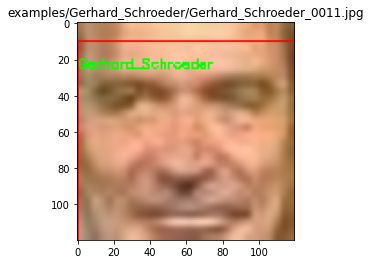

Detecting face  85  out of  90
[INFO] recognizing faces in  examples/Junichiro_Koizumi/Junichiro_Koizumi_0011.jpg
Correct face recognized


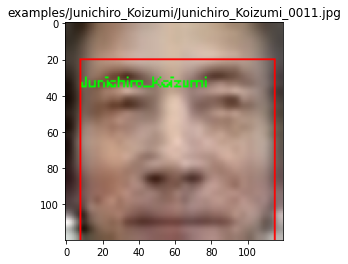

Detecting face  86  out of  90
[INFO] recognizing faces in  examples/Junichiro_Koizumi/Junichiro_Koizumi_0013.jpg
Correct face recognized


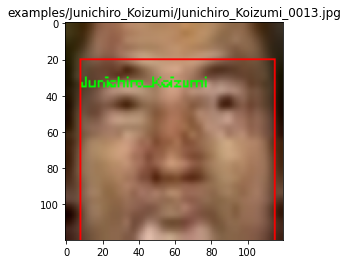

Detecting face  87  out of  90
[INFO] recognizing faces in  examples/Junichiro_Koizumi/Junichiro_Koizumi_0012.jpg
Correct face recognized


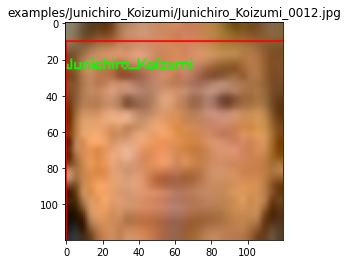

Detecting face  88  out of  90
[INFO] recognizing faces in  examples/Jennifer_Capriati/Jennifer_Capriati_0013.jpg
Correct face recognized


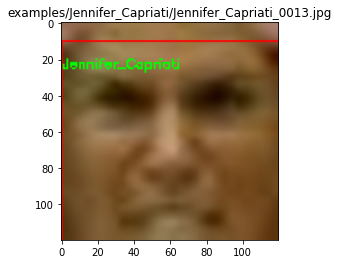

Detecting face  89  out of  90
[INFO] recognizing faces in  examples/Jennifer_Capriati/Jennifer_Capriati_0011.jpg
Correct face recognized


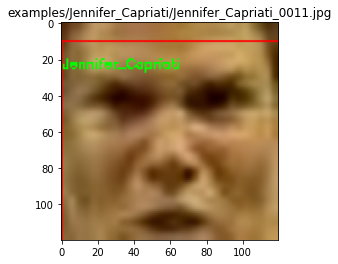

Detecting face  90  out of  90
[INFO] recognizing faces in  examples/Jennifer_Capriati/Jennifer_Capriati_0012.jpg
Correct face recognized


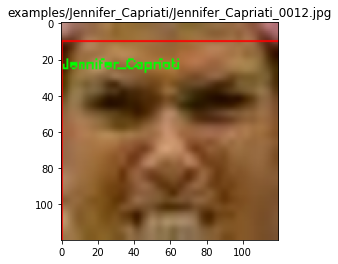

Summary
Total pictures 90
Faces identified correctly:  79
Faces identified wrongly:  6
Faces not identified:  5
Absolute Accuracy (correct / [correct + incorrect + not detected]) * 100%: 
88.0 %
Detection Accuracy [(correct + incorrect) / total] * 100%: 
94.44 %
END, time taken:  55.84 seconds
Avg. secs. per picture:  0.62 seconds


In [18]:
print("Face identification: Scalin with bicubic")
print("=========================================================")
recognize_face("scale", "examples")

Face identification: Scalin with bicubic
[INFO] loading encodings...
Detecting face  1  out of  90
[INFO] recognizing faces in  examples/Roh_Moo-hyun/Roh_Moo-hyun_0013.jpg
Correct face recognized


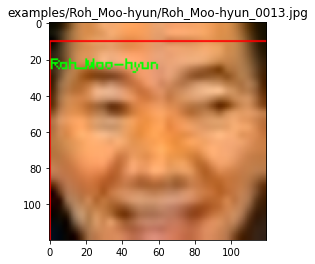

Detecting face  2  out of  90
[INFO] recognizing faces in  examples/Roh_Moo-hyun/Roh_Moo-hyun_0011.jpg
Correct face recognized


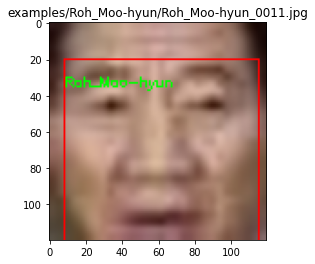

Detecting face  3  out of  90
[INFO] recognizing faces in  examples/Roh_Moo-hyun/Roh_Moo-hyun_0012.jpg
Correct face recognized


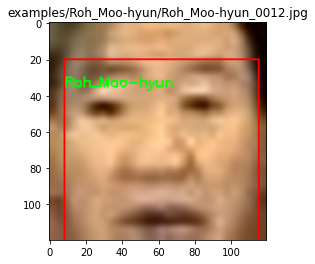

Detecting face  4  out of  90
[INFO] recognizing faces in  examples/Gloria_Macapagal_Arroyo/Gloria_Macapagal_Arroyo_0011.jpg
Correct face recognized


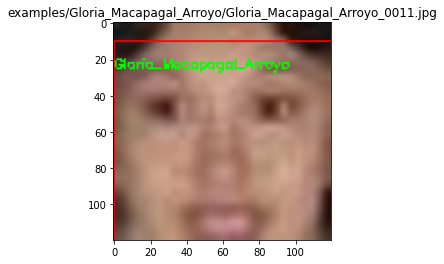

Detecting face  5  out of  90
[INFO] recognizing faces in  examples/Gloria_Macapagal_Arroyo/Gloria_Macapagal_Arroyo_0012.jpg
Correct face recognized


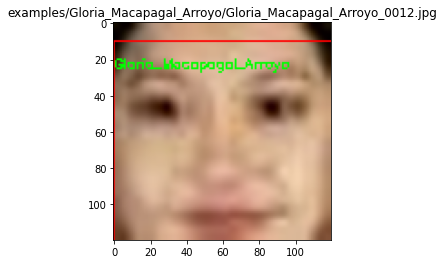

Detecting face  6  out of  90
[INFO] recognizing faces in  examples/Gloria_Macapagal_Arroyo/Gloria_Macapagal_Arroyo_0013.jpg
Folder name is:  ['Gloria_Macapagal_Arroyo'] . However, face detected is: ['Megawati_Sukarnoputri']


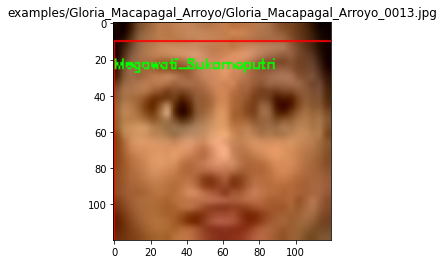

Detecting face  7  out of  90
[INFO] recognizing faces in  examples/Hans_Blix/Hans_Blix_0011.jpg
Correct face recognized


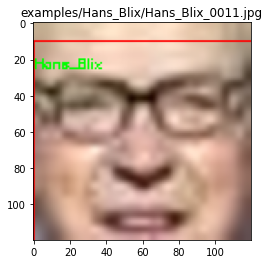

Detecting face  8  out of  90
[INFO] recognizing faces in  examples/Hans_Blix/Hans_Blix_0012.jpg
Correct face recognized


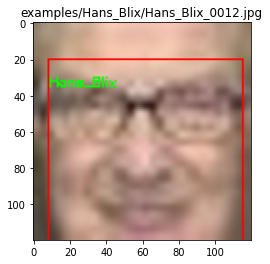

Detecting face  9  out of  90
[INFO] recognizing faces in  examples/Hans_Blix/Hans_Blix_0013.jpg
Correct face recognized


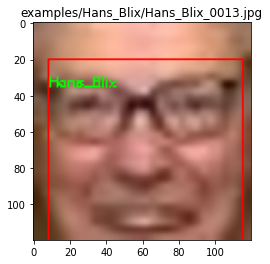

Detecting face  10  out of  90
[INFO] recognizing faces in  examples/Silvio_Berlusconi/Silvio_Berlusconi_0012.jpg
Correct face recognized


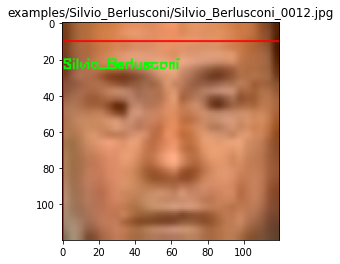

Detecting face  11  out of  90
[INFO] recognizing faces in  examples/Silvio_Berlusconi/Silvio_Berlusconi_0011.jpg
Correct face recognized


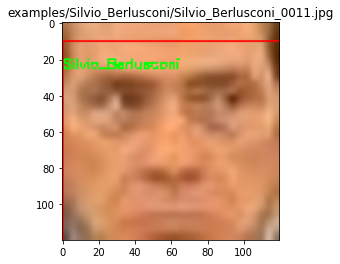

Detecting face  12  out of  90
[INFO] recognizing faces in  examples/Silvio_Berlusconi/Silvio_Berlusconi_0013.jpg
Correct face recognized


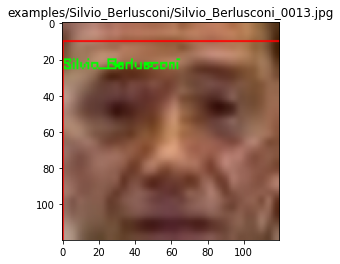

Detecting face  13  out of  90
[INFO] recognizing faces in  examples/Laura_Bush/Laura_Bush_0012.jpg
Correct face recognized


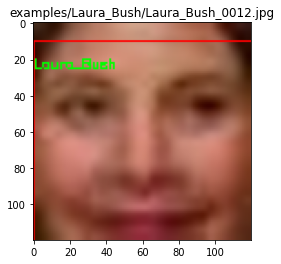

Detecting face  14  out of  90
[INFO] recognizing faces in  examples/Laura_Bush/Laura_Bush_0013.jpg
Correct face recognized


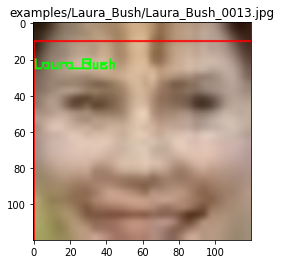

Detecting face  15  out of  90
[INFO] recognizing faces in  examples/Laura_Bush/Laura_Bush_0011.jpg
Folder name is:  ['Laura_Bush'] . However, face detected is: []


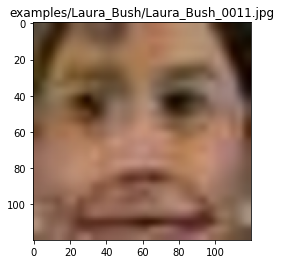

Detecting face  16  out of  90
[INFO] recognizing faces in  examples/John_Ashcroft/John_Ashcroft_0013.jpg
Correct face recognized


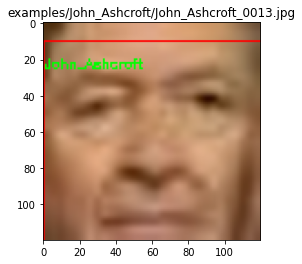

Detecting face  17  out of  90
[INFO] recognizing faces in  examples/John_Ashcroft/John_Ashcroft_0012.jpg
Correct face recognized


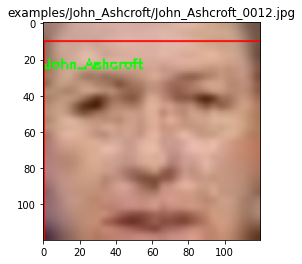

Detecting face  18  out of  90
[INFO] recognizing faces in  examples/John_Ashcroft/John_Ashcroft_0011.jpg
Correct face recognized


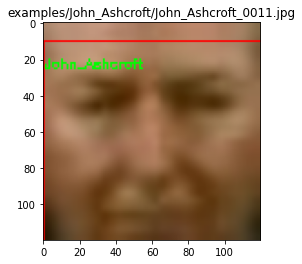

Detecting face  19  out of  90
[INFO] recognizing faces in  examples/Tom_Ridge/Tom_Ridge_0013.jpg
Correct face recognized


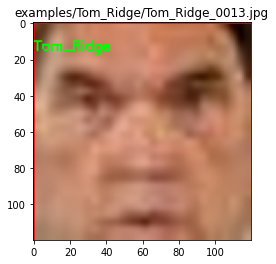

Detecting face  20  out of  90
[INFO] recognizing faces in  examples/Tom_Ridge/Tom_Ridge_0012.jpg
Correct face recognized


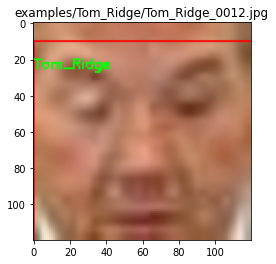

Detecting face  21  out of  90
[INFO] recognizing faces in  examples/Tom_Ridge/Tom_Ridge_0011.jpg
Correct face recognized


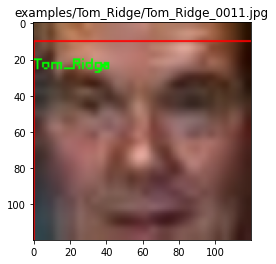

Detecting face  22  out of  90
[INFO] recognizing faces in  examples/Andre_Agassi/Andre_Agassi_0012.jpg
Correct face recognized


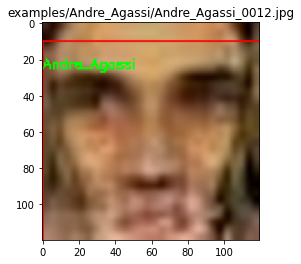

Detecting face  23  out of  90
[INFO] recognizing faces in  examples/Andre_Agassi/Andre_Agassi_0011.jpg
Correct face recognized


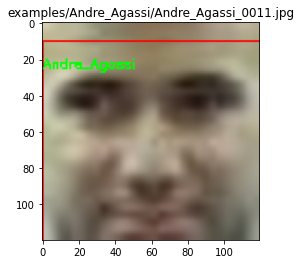

Detecting face  24  out of  90
[INFO] recognizing faces in  examples/Andre_Agassi/Andre_Agassi_0013.jpg
Correct face recognized


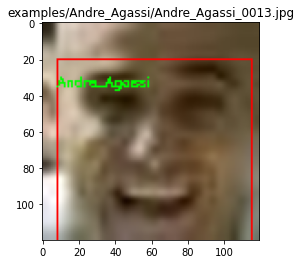

Detecting face  25  out of  90
[INFO] recognizing faces in  examples/Vicente_Fox/Vicente_Fox_0011.jpg
Correct face recognized


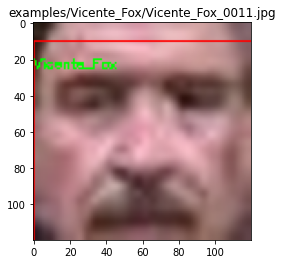

Detecting face  26  out of  90
[INFO] recognizing faces in  examples/Vicente_Fox/Vicente_Fox_0013.jpg
Correct face recognized


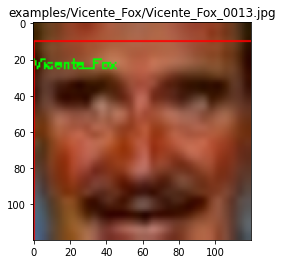

Detecting face  27  out of  90
[INFO] recognizing faces in  examples/Vicente_Fox/Vicente_Fox_0012.jpg
Correct face recognized


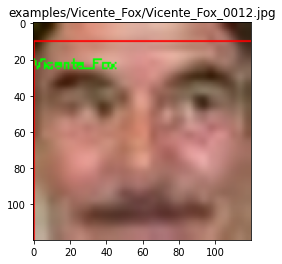

Detecting face  28  out of  90
[INFO] recognizing faces in  examples/Colin_Powell/Colin_Powell_0012.jpg
Correct face recognized


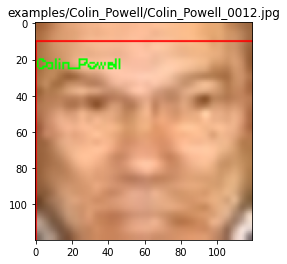

Detecting face  29  out of  90
[INFO] recognizing faces in  examples/Colin_Powell/Colin_Powell_0013.jpg
Correct face recognized


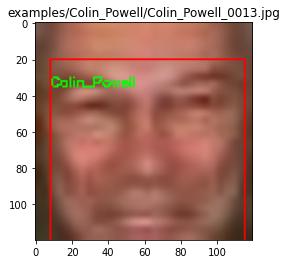

Detecting face  30  out of  90
[INFO] recognizing faces in  examples/Colin_Powell/Colin_Powell_0011.jpg
Correct face recognized


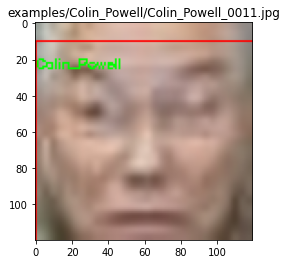

Detecting face  31  out of  90
[INFO] recognizing faces in  examples/Luiz_Inacio_Lula_da_Silva/Luiz_Inacio_Lula_da_Silva_0011.jpg
Correct face recognized


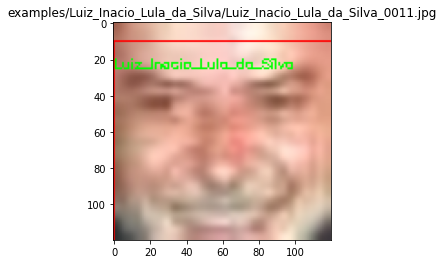

Detecting face  32  out of  90
[INFO] recognizing faces in  examples/Luiz_Inacio_Lula_da_Silva/Luiz_Inacio_Lula_da_Silva_0012.jpg
Correct face recognized


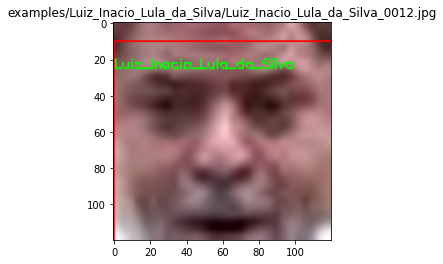

Detecting face  33  out of  90
[INFO] recognizing faces in  examples/Luiz_Inacio_Lula_da_Silva/Luiz_Inacio_Lula_da_Silva_0013.jpg
Correct face recognized


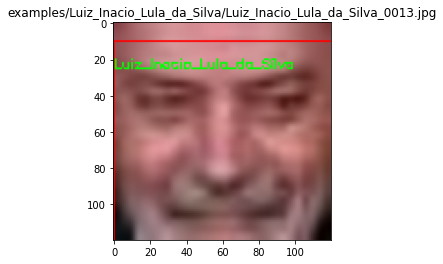

Detecting face  34  out of  90
[INFO] recognizing faces in  examples/Alejandro_Toledo/Alejandro_Toledo_0012.jpg
Correct face recognized


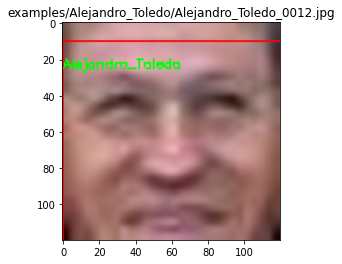

Detecting face  35  out of  90
[INFO] recognizing faces in  examples/Alejandro_Toledo/Alejandro_Toledo_0011.jpg
Correct face recognized


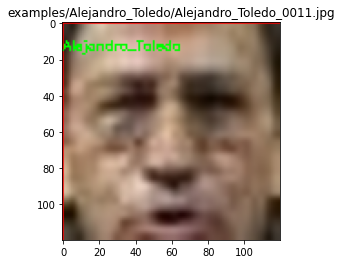

Detecting face  36  out of  90
[INFO] recognizing faces in  examples/Alejandro_Toledo/Alejandro_Toledo_0013.jpg
Folder name is:  ['Alejandro_Toledo'] . However, face detected is: ['Hugo_Chavez']


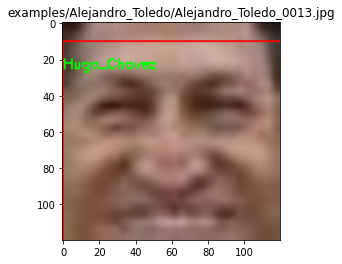

Detecting face  37  out of  90
[INFO] recognizing faces in  examples/Megawati_Sukarnoputri/Megawati_Sukarnoputri_0011.jpg
Correct face recognized


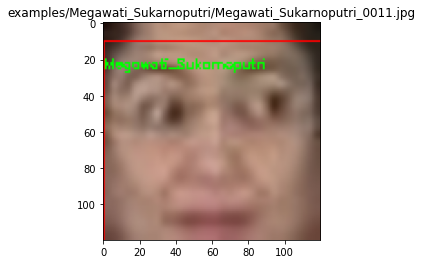

Detecting face  38  out of  90
[INFO] recognizing faces in  examples/Megawati_Sukarnoputri/Megawati_Sukarnoputri_0013.jpg
Correct face recognized


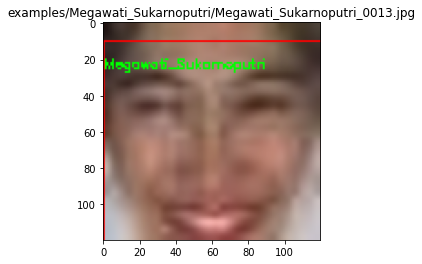

Detecting face  39  out of  90
[INFO] recognizing faces in  examples/Megawati_Sukarnoputri/Megawati_Sukarnoputri_0012.jpg
Correct face recognized


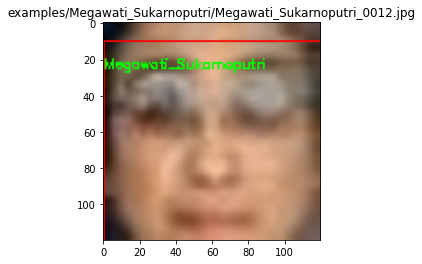

Detecting face  40  out of  90
[INFO] recognizing faces in  examples/Lleyton_Hewitt/Lleyton_Hewitt_0013.jpg
Correct face recognized


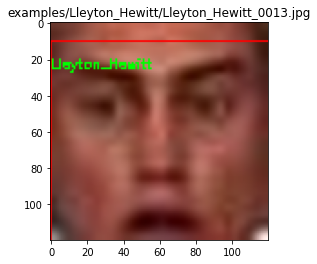

Detecting face  41  out of  90
[INFO] recognizing faces in  examples/Lleyton_Hewitt/Lleyton_Hewitt_0011.jpg
Correct face recognized


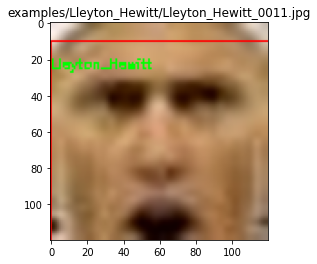

Detecting face  42  out of  90
[INFO] recognizing faces in  examples/Lleyton_Hewitt/Lleyton_Hewitt_0012.jpg
Correct face recognized


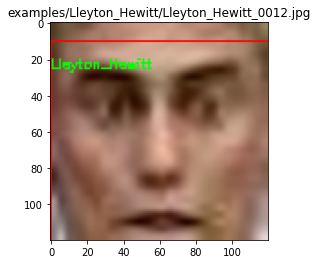

Detecting face  43  out of  90
[INFO] recognizing faces in  examples/Unknown/Aaron_Eckhart_A.jpg
Folder name is:  ['Unknown'] . However, face detected is: ['Silvio_Berlusconi']


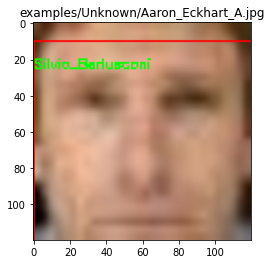

Detecting face  44  out of  90
[INFO] recognizing faces in  examples/Unknown/Aaron_Guiel_B.jpg
Folder name is:  ['Unknown'] . However, face detected is: []


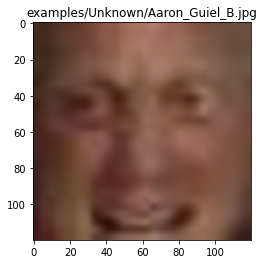

Detecting face  45  out of  90
[INFO] recognizing faces in  examples/Unknown/Adriana_Lima_C.jpg
Correct face recognized


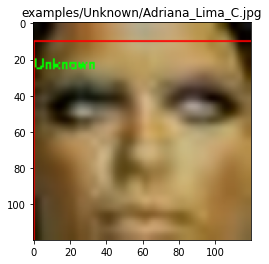

Detecting face  46  out of  90
[INFO] recognizing faces in  examples/George_W_Bush/George_W_Bush_0013.jpg
Correct face recognized


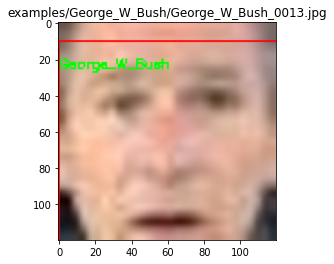

Detecting face  47  out of  90
[INFO] recognizing faces in  examples/George_W_Bush/George_W_Bush_0011.jpg
Correct face recognized


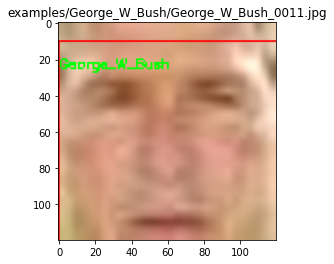

Detecting face  48  out of  90
[INFO] recognizing faces in  examples/George_W_Bush/George_W_Bush_0012.jpg
Correct face recognized


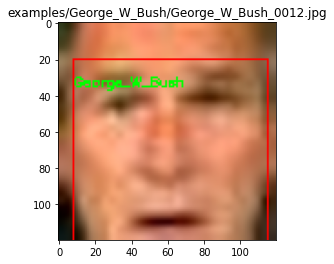

Detecting face  49  out of  90
[INFO] recognizing faces in  examples/Nestor_Kirchner/Nestor_Kirchner_0012.jpg
Correct face recognized


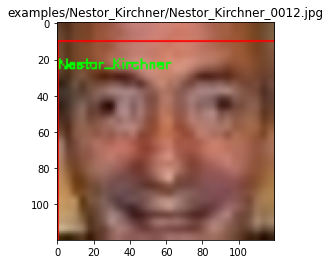

Detecting face  50  out of  90
[INFO] recognizing faces in  examples/Nestor_Kirchner/Nestor_Kirchner_0013.jpg
Correct face recognized


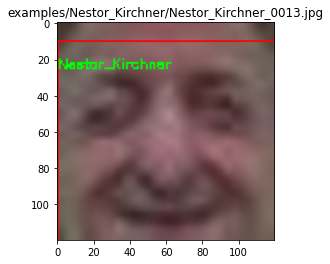

Detecting face  51  out of  90
[INFO] recognizing faces in  examples/Nestor_Kirchner/Nestor_Kirchner_0011.jpg
Correct face recognized


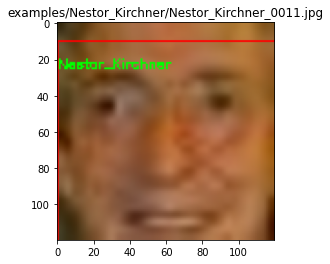

Detecting face  52  out of  90
[INFO] recognizing faces in  examples/Alvaro_Uribe/Alvaro_Uribe_0012.jpg
Correct face recognized


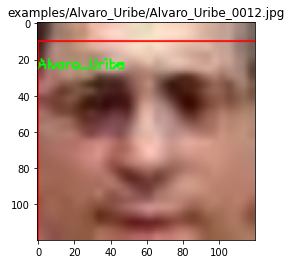

Detecting face  53  out of  90
[INFO] recognizing faces in  examples/Alvaro_Uribe/Alvaro_Uribe_0011.jpg
Correct face recognized


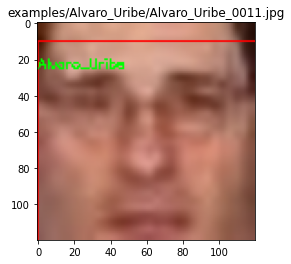

Detecting face  54  out of  90
[INFO] recognizing faces in  examples/Alvaro_Uribe/Alvaro_Uribe_0013.jpg
Correct face recognized


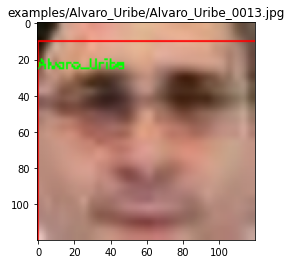

Detecting face  55  out of  90
[INFO] recognizing faces in  examples/Tony_Blair/Tony_Blair_0011.jpg
Correct face recognized


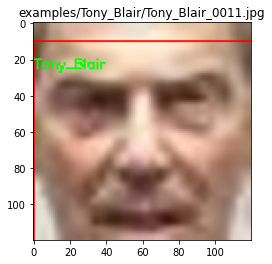

Detecting face  56  out of  90
[INFO] recognizing faces in  examples/Tony_Blair/Tony_Blair_0012.jpg
Correct face recognized


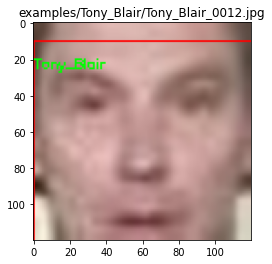

Detecting face  57  out of  90
[INFO] recognizing faces in  examples/Tony_Blair/Tony_Blair_0013.jpg
Correct face recognized


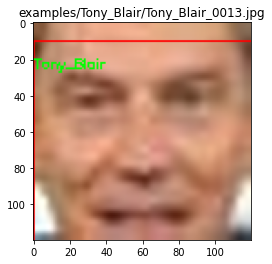

Detecting face  58  out of  90
[INFO] recognizing faces in  examples/Kofi_Annan/Kofi_Annan_0011.jpg
Correct face recognized


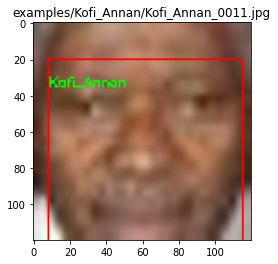

Detecting face  59  out of  90
[INFO] recognizing faces in  examples/Kofi_Annan/Kofi_Annan_0013.jpg
Correct face recognized


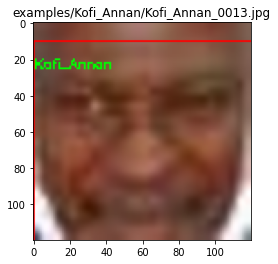

Detecting face  60  out of  90
[INFO] recognizing faces in  examples/Kofi_Annan/Kofi_Annan_0012.jpg
Correct face recognized


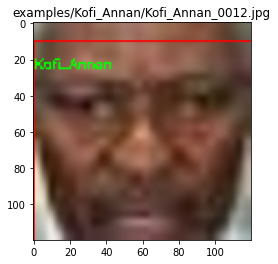

Detecting face  61  out of  90
[INFO] recognizing faces in  examples/Arnold_Schwarzenegger/Arnold_Schwarzenegger_0012.jpg
Correct face recognized


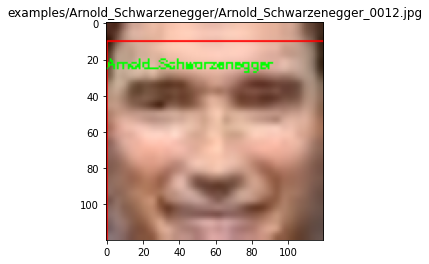

Detecting face  62  out of  90
[INFO] recognizing faces in  examples/Arnold_Schwarzenegger/Arnold_Schwarzenegger_0011.jpg
Folder name is:  ['Arnold_Schwarzenegger'] . However, face detected is: []


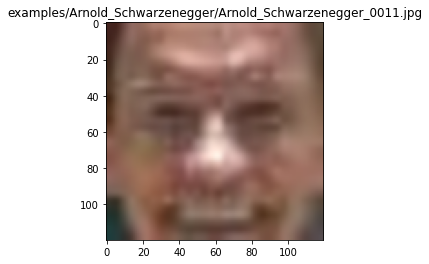

Detecting face  63  out of  90
[INFO] recognizing faces in  examples/Arnold_Schwarzenegger/Arnold_Schwarzenegger_0013.jpg
Folder name is:  ['Arnold_Schwarzenegger'] . However, face detected is: ['Alvaro_Uribe']


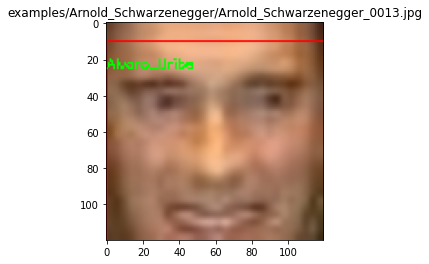

Detecting face  64  out of  90
[INFO] recognizing faces in  examples/Jacques_Chirac/Jacques_Chirac_0011.jpg
Correct face recognized


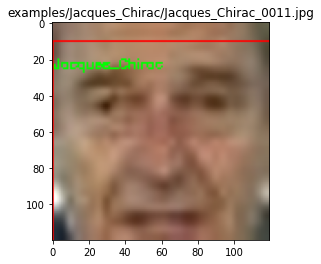

Detecting face  65  out of  90
[INFO] recognizing faces in  examples/Jacques_Chirac/Jacques_Chirac_0013.jpg
Correct face recognized


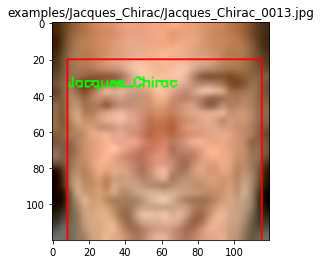

Detecting face  66  out of  90
[INFO] recognizing faces in  examples/Jacques_Chirac/Jacques_Chirac_0012.jpg
Correct face recognized


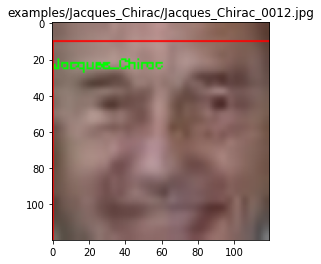

Detecting face  67  out of  90
[INFO] recognizing faces in  examples/Donald_Rumsfeld/Donald_Rumsfeld_0011.jpg
Correct face recognized


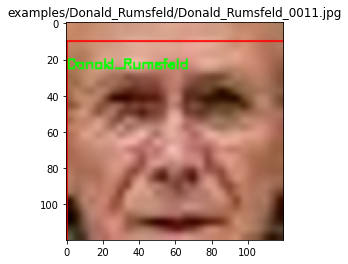

Detecting face  68  out of  90
[INFO] recognizing faces in  examples/Donald_Rumsfeld/Donald_Rumsfeld_0013.jpg
Folder name is:  ['Donald_Rumsfeld'] . However, face detected is: ['Silvio_Berlusconi']


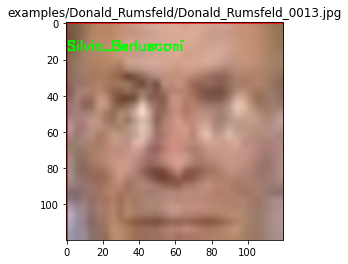

Detecting face  69  out of  90
[INFO] recognizing faces in  examples/Donald_Rumsfeld/Donald_Rumsfeld_0012.jpg
Correct face recognized


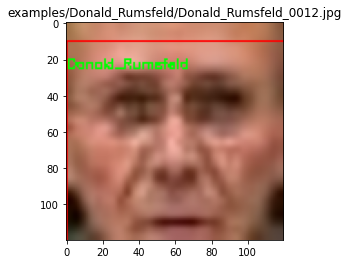

Detecting face  70  out of  90
[INFO] recognizing faces in  examples/Ariel_Sharon/Ariel_Sharon_0013.jpg
Correct face recognized


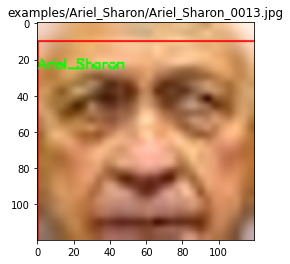

Detecting face  71  out of  90
[INFO] recognizing faces in  examples/Ariel_Sharon/Ariel_Sharon_0011.jpg
Correct face recognized


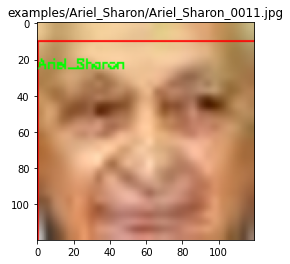

Detecting face  72  out of  90
[INFO] recognizing faces in  examples/Ariel_Sharon/Ariel_Sharon_0012.jpg
Correct face recognized


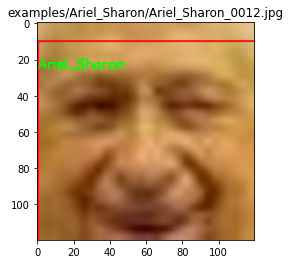

Detecting face  73  out of  90
[INFO] recognizing faces in  examples/Hugo_Chavez/Hugo_Chavez_0011.jpg
Correct face recognized


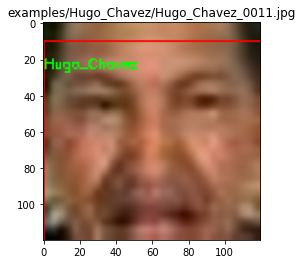

Detecting face  74  out of  90
[INFO] recognizing faces in  examples/Hugo_Chavez/Hugo_Chavez_0012.jpg
Correct face recognized


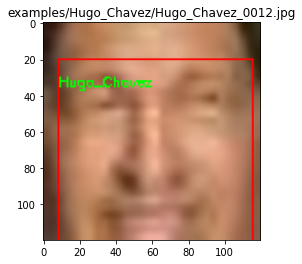

Detecting face  75  out of  90
[INFO] recognizing faces in  examples/Hugo_Chavez/Hugo_Chavez_0013.jpg
Correct face recognized


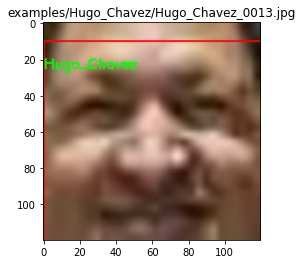

Detecting face  76  out of  90
[INFO] recognizing faces in  examples/Serena_Williams/Serena_Williams_0013.jpg
Correct face recognized


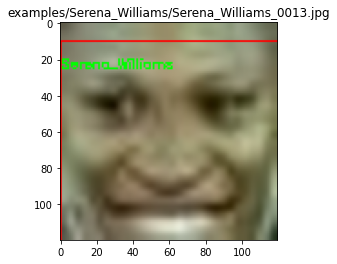

Detecting face  77  out of  90
[INFO] recognizing faces in  examples/Serena_Williams/Serena_Williams_0011.jpg
Folder name is:  ['Serena_Williams'] . However, face detected is: []


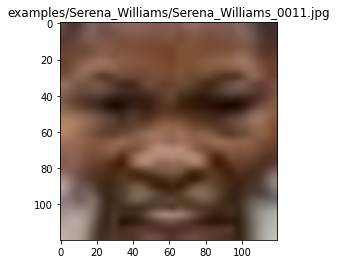

Detecting face  78  out of  90
[INFO] recognizing faces in  examples/Serena_Williams/Serena_Williams_0012.jpg
Folder name is:  ['Serena_Williams'] . However, face detected is: []


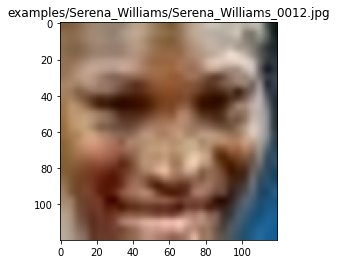

Detecting face  79  out of  90
[INFO] recognizing faces in  examples/Jean_Chretien/Jean_Chretien_0013.jpg
Folder name is:  ['Jean_Chretien'] . However, face detected is: ['Ariel_Sharon']


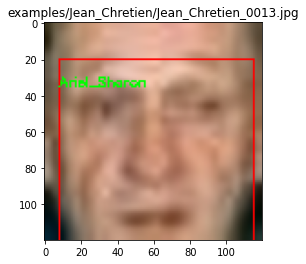

Detecting face  80  out of  90
[INFO] recognizing faces in  examples/Jean_Chretien/Jean_Chretien_0011.jpg
Correct face recognized


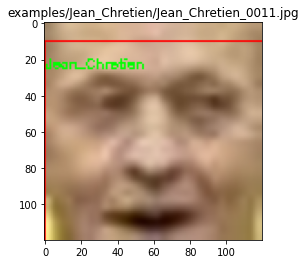

Detecting face  81  out of  90
[INFO] recognizing faces in  examples/Jean_Chretien/Jean_Chretien_0012.jpg
Correct face recognized


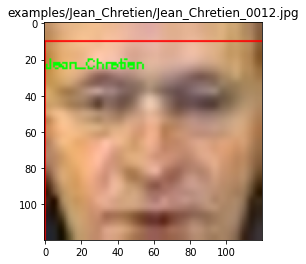

Detecting face  82  out of  90
[INFO] recognizing faces in  examples/Gerhard_Schroeder/Gerhard_Schroeder_0012.jpg
Correct face recognized


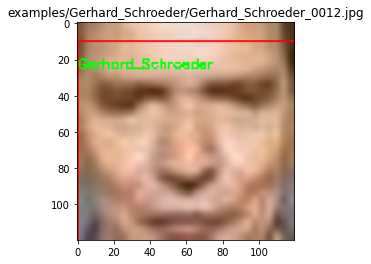

Detecting face  83  out of  90
[INFO] recognizing faces in  examples/Gerhard_Schroeder/Gerhard_Schroeder_0013.jpg
Correct face recognized


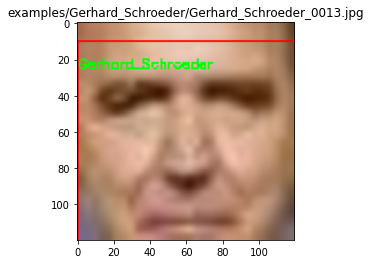

Detecting face  84  out of  90
[INFO] recognizing faces in  examples/Gerhard_Schroeder/Gerhard_Schroeder_0011.jpg
Correct face recognized


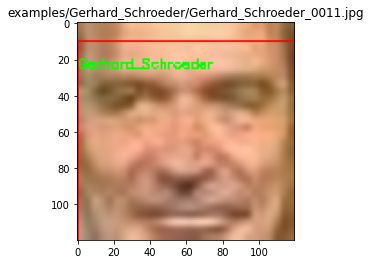

Detecting face  85  out of  90
[INFO] recognizing faces in  examples/Junichiro_Koizumi/Junichiro_Koizumi_0011.jpg
Correct face recognized


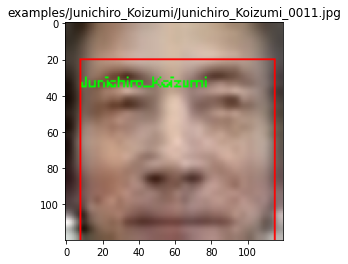

Detecting face  86  out of  90
[INFO] recognizing faces in  examples/Junichiro_Koizumi/Junichiro_Koizumi_0013.jpg
Correct face recognized


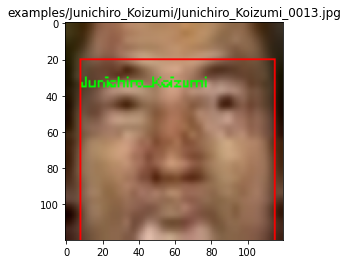

Detecting face  87  out of  90
[INFO] recognizing faces in  examples/Junichiro_Koizumi/Junichiro_Koizumi_0012.jpg
Correct face recognized


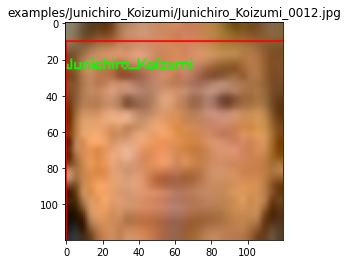

Detecting face  88  out of  90
[INFO] recognizing faces in  examples/Jennifer_Capriati/Jennifer_Capriati_0013.jpg
Correct face recognized


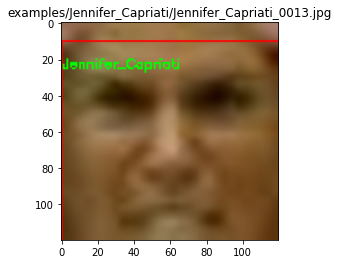

Detecting face  89  out of  90
[INFO] recognizing faces in  examples/Jennifer_Capriati/Jennifer_Capriati_0011.jpg
Correct face recognized


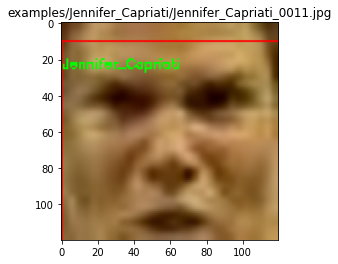

Detecting face  90  out of  90
[INFO] recognizing faces in  examples/Jennifer_Capriati/Jennifer_Capriati_0012.jpg
Correct face recognized


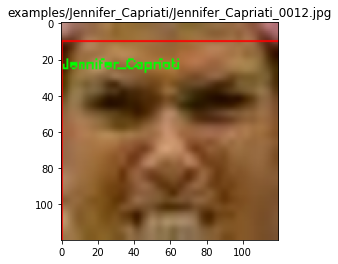

Summary
Total pictures 90
Faces identified correctly:  79
Faces identified wrongly:  6
Faces not identified:  5
Absolute Accuracy (correct / [correct + incorrect + not detected]) * 100%: 
88.0 %
Detection Accuracy [(correct + incorrect) / total] * 100%: 
94.44 %
END, time taken:  59.92 seconds
Avg. secs. per picture:  0.67 seconds


In [19]:
print("Face identification: Scalin with bicubic")
print("=========================================================")
recognize_face("scale", "examples")

Face identification: Scalin with EDSR
[INFO] loading encodings...
Detecting face  1  out of  90
[INFO] recognizing faces in  examples/Roh_Moo-hyun/Roh_Moo-hyun_0013.jpg
Correct face recognized


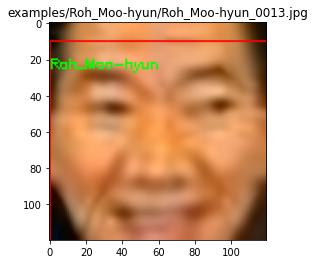

Detecting face  2  out of  90
[INFO] recognizing faces in  examples/Roh_Moo-hyun/Roh_Moo-hyun_0011.jpg
Correct face recognized


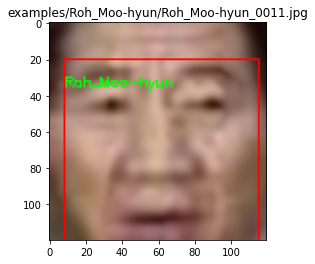

Detecting face  3  out of  90
[INFO] recognizing faces in  examples/Roh_Moo-hyun/Roh_Moo-hyun_0012.jpg
Correct face recognized


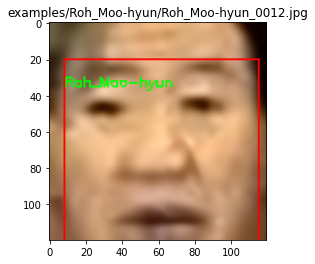

Detecting face  4  out of  90
[INFO] recognizing faces in  examples/Gloria_Macapagal_Arroyo/Gloria_Macapagal_Arroyo_0011.jpg
Correct face recognized


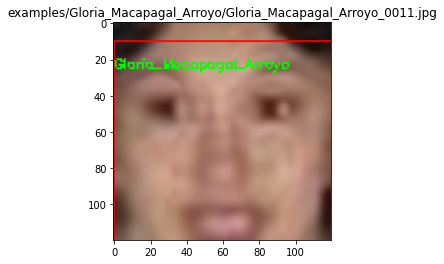

Detecting face  5  out of  90
[INFO] recognizing faces in  examples/Gloria_Macapagal_Arroyo/Gloria_Macapagal_Arroyo_0012.jpg
Correct face recognized


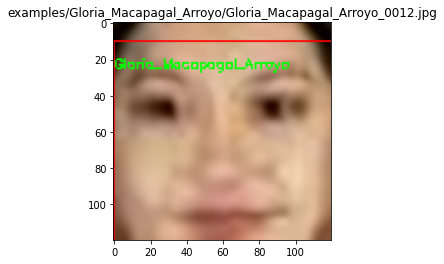

Detecting face  6  out of  90
[INFO] recognizing faces in  examples/Gloria_Macapagal_Arroyo/Gloria_Macapagal_Arroyo_0013.jpg
Folder name is:  ['Gloria_Macapagal_Arroyo'] . However, face detected is: ['Megawati_Sukarnoputri']


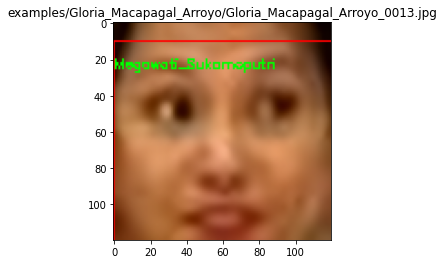

Detecting face  7  out of  90
[INFO] recognizing faces in  examples/Hans_Blix/Hans_Blix_0011.jpg
Correct face recognized


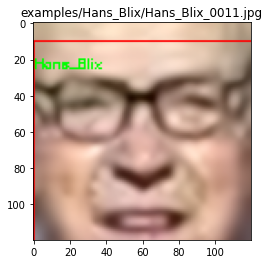

Detecting face  8  out of  90
[INFO] recognizing faces in  examples/Hans_Blix/Hans_Blix_0012.jpg
Correct face recognized


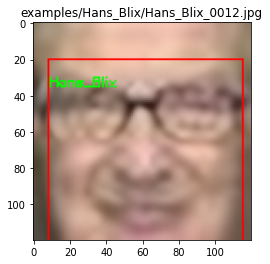

Detecting face  9  out of  90
[INFO] recognizing faces in  examples/Hans_Blix/Hans_Blix_0013.jpg
Correct face recognized


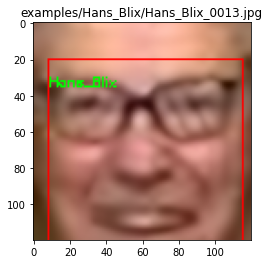

Detecting face  10  out of  90
[INFO] recognizing faces in  examples/Silvio_Berlusconi/Silvio_Berlusconi_0012.jpg
Correct face recognized


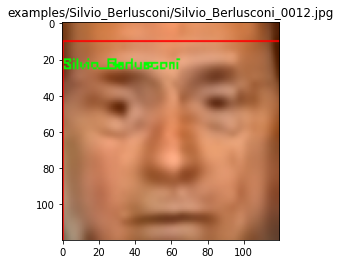

Detecting face  11  out of  90
[INFO] recognizing faces in  examples/Silvio_Berlusconi/Silvio_Berlusconi_0011.jpg
Correct face recognized


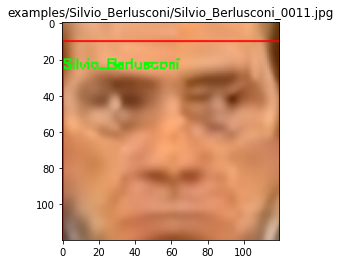

Detecting face  12  out of  90
[INFO] recognizing faces in  examples/Silvio_Berlusconi/Silvio_Berlusconi_0013.jpg
Correct face recognized


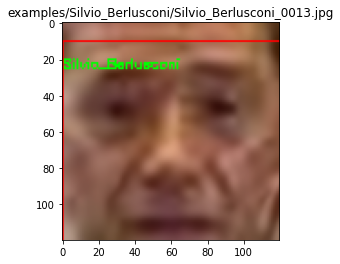

Detecting face  13  out of  90
[INFO] recognizing faces in  examples/Laura_Bush/Laura_Bush_0012.jpg
Correct face recognized


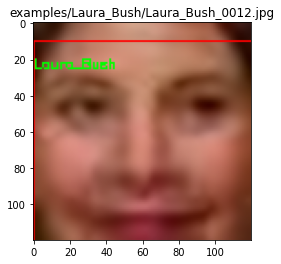

Detecting face  14  out of  90
[INFO] recognizing faces in  examples/Laura_Bush/Laura_Bush_0013.jpg
Correct face recognized


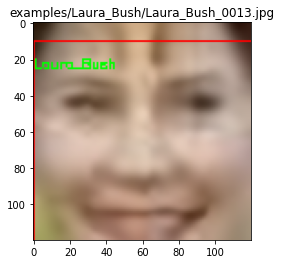

Detecting face  15  out of  90
[INFO] recognizing faces in  examples/Laura_Bush/Laura_Bush_0011.jpg
Correct face recognized


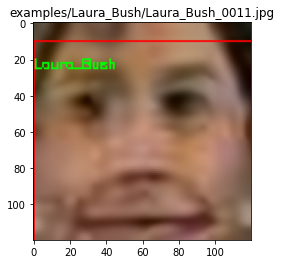

Detecting face  16  out of  90
[INFO] recognizing faces in  examples/John_Ashcroft/John_Ashcroft_0013.jpg
Correct face recognized


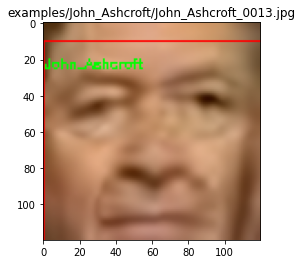

Detecting face  17  out of  90
[INFO] recognizing faces in  examples/John_Ashcroft/John_Ashcroft_0012.jpg
Correct face recognized


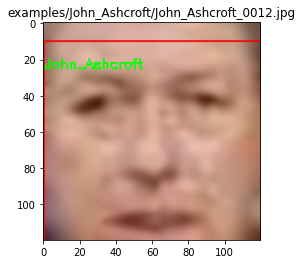

Detecting face  18  out of  90
[INFO] recognizing faces in  examples/John_Ashcroft/John_Ashcroft_0011.jpg
Correct face recognized


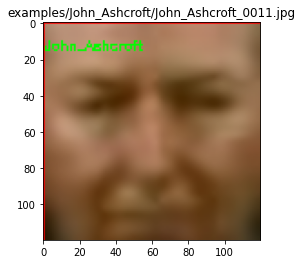

Detecting face  19  out of  90
[INFO] recognizing faces in  examples/Tom_Ridge/Tom_Ridge_0013.jpg
Correct face recognized


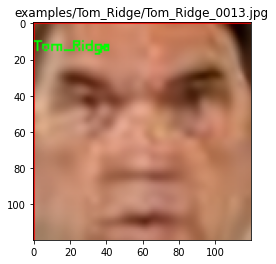

Detecting face  20  out of  90
[INFO] recognizing faces in  examples/Tom_Ridge/Tom_Ridge_0012.jpg
Correct face recognized


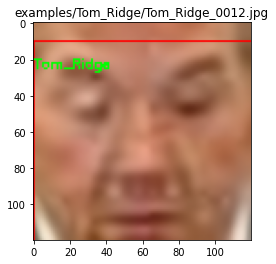

Detecting face  21  out of  90
[INFO] recognizing faces in  examples/Tom_Ridge/Tom_Ridge_0011.jpg
Correct face recognized


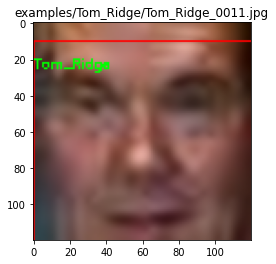

Detecting face  22  out of  90
[INFO] recognizing faces in  examples/Andre_Agassi/Andre_Agassi_0012.jpg
Correct face recognized


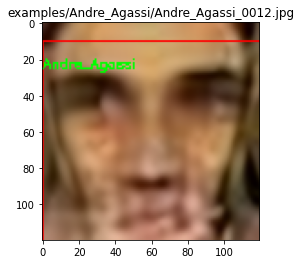

Detecting face  23  out of  90
[INFO] recognizing faces in  examples/Andre_Agassi/Andre_Agassi_0011.jpg
Correct face recognized


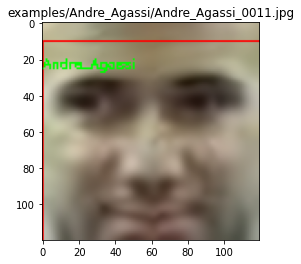

Detecting face  24  out of  90
[INFO] recognizing faces in  examples/Andre_Agassi/Andre_Agassi_0013.jpg
Correct face recognized


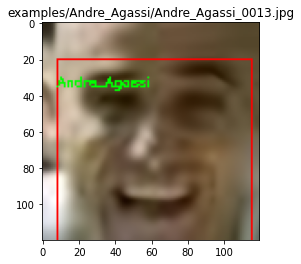

Detecting face  25  out of  90
[INFO] recognizing faces in  examples/Vicente_Fox/Vicente_Fox_0011.jpg
Correct face recognized


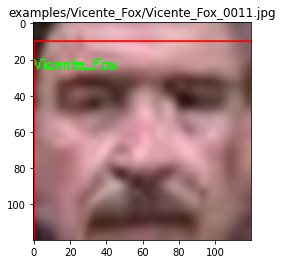

Detecting face  26  out of  90
[INFO] recognizing faces in  examples/Vicente_Fox/Vicente_Fox_0013.jpg
Correct face recognized


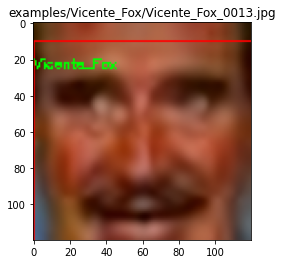

Detecting face  27  out of  90
[INFO] recognizing faces in  examples/Vicente_Fox/Vicente_Fox_0012.jpg
Correct face recognized


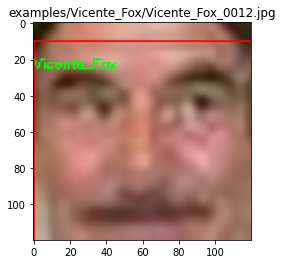

Detecting face  28  out of  90
[INFO] recognizing faces in  examples/Colin_Powell/Colin_Powell_0012.jpg
Correct face recognized


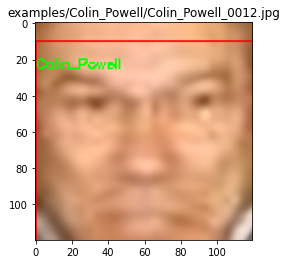

Detecting face  29  out of  90
[INFO] recognizing faces in  examples/Colin_Powell/Colin_Powell_0013.jpg
Correct face recognized


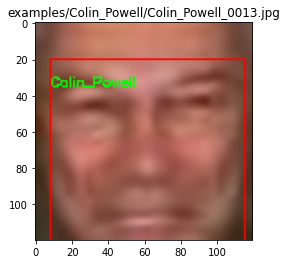

Detecting face  30  out of  90
[INFO] recognizing faces in  examples/Colin_Powell/Colin_Powell_0011.jpg
Correct face recognized


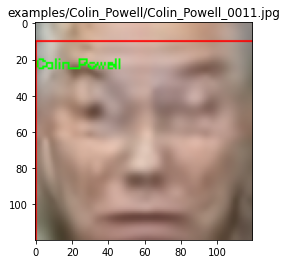

Detecting face  31  out of  90
[INFO] recognizing faces in  examples/Luiz_Inacio_Lula_da_Silva/Luiz_Inacio_Lula_da_Silva_0011.jpg
Correct face recognized


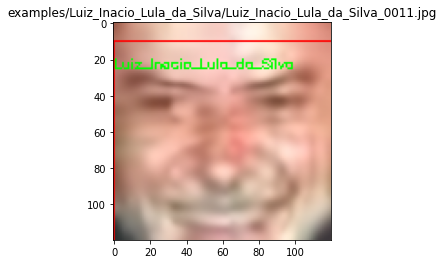

Detecting face  32  out of  90
[INFO] recognizing faces in  examples/Luiz_Inacio_Lula_da_Silva/Luiz_Inacio_Lula_da_Silva_0012.jpg
Correct face recognized


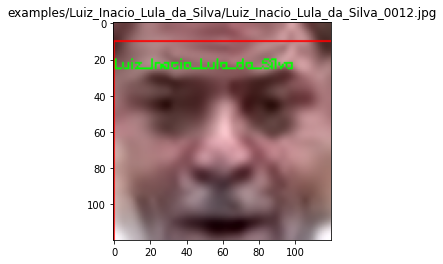

Detecting face  33  out of  90
[INFO] recognizing faces in  examples/Luiz_Inacio_Lula_da_Silva/Luiz_Inacio_Lula_da_Silva_0013.jpg
Correct face recognized


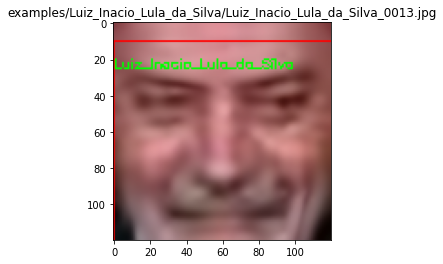

Detecting face  34  out of  90
[INFO] recognizing faces in  examples/Alejandro_Toledo/Alejandro_Toledo_0012.jpg
Correct face recognized


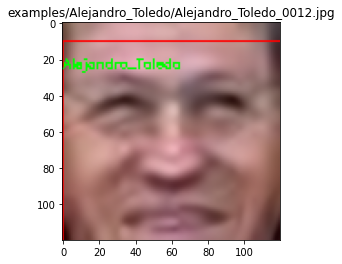

Detecting face  35  out of  90
[INFO] recognizing faces in  examples/Alejandro_Toledo/Alejandro_Toledo_0011.jpg
Correct face recognized


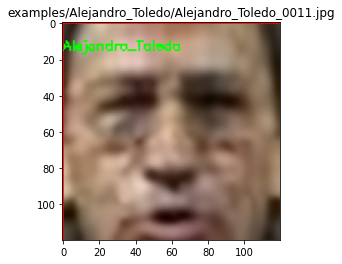

Detecting face  36  out of  90
[INFO] recognizing faces in  examples/Alejandro_Toledo/Alejandro_Toledo_0013.jpg
Correct face recognized


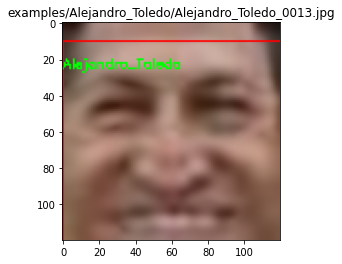

Detecting face  37  out of  90
[INFO] recognizing faces in  examples/Megawati_Sukarnoputri/Megawati_Sukarnoputri_0011.jpg
Correct face recognized


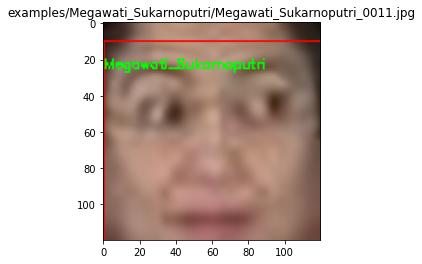

Detecting face  38  out of  90
[INFO] recognizing faces in  examples/Megawati_Sukarnoputri/Megawati_Sukarnoputri_0013.jpg
Correct face recognized


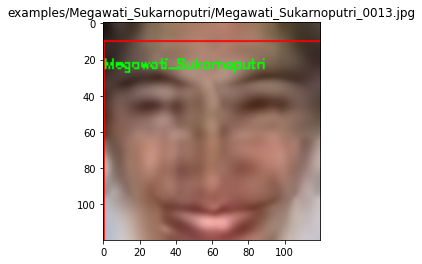

Detecting face  39  out of  90
[INFO] recognizing faces in  examples/Megawati_Sukarnoputri/Megawati_Sukarnoputri_0012.jpg
Correct face recognized


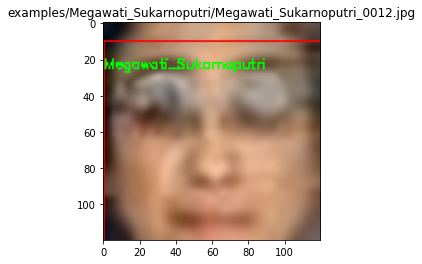

Detecting face  40  out of  90
[INFO] recognizing faces in  examples/Lleyton_Hewitt/Lleyton_Hewitt_0013.jpg
Correct face recognized


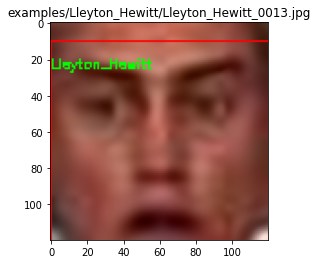

Detecting face  41  out of  90
[INFO] recognizing faces in  examples/Lleyton_Hewitt/Lleyton_Hewitt_0011.jpg
Correct face recognized


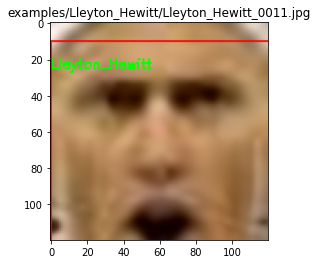

Detecting face  42  out of  90
[INFO] recognizing faces in  examples/Lleyton_Hewitt/Lleyton_Hewitt_0012.jpg
Correct face recognized


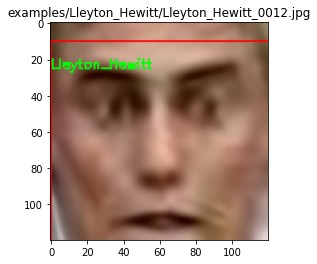

Detecting face  43  out of  90
[INFO] recognizing faces in  examples/Unknown/Aaron_Eckhart_A.jpg
Folder name is:  ['Unknown'] . However, face detected is: ['Silvio_Berlusconi']


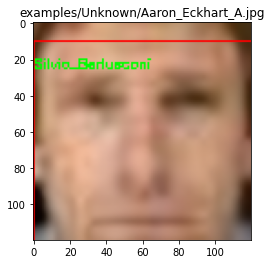

Detecting face  44  out of  90
[INFO] recognizing faces in  examples/Unknown/Aaron_Guiel_B.jpg
Folder name is:  ['Unknown'] . However, face detected is: []


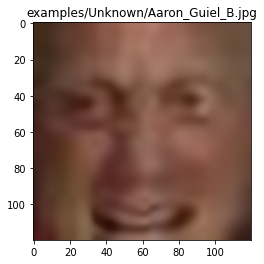

Detecting face  45  out of  90
[INFO] recognizing faces in  examples/Unknown/Adriana_Lima_C.jpg
Correct face recognized


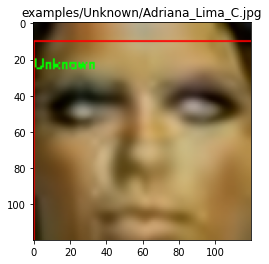

Detecting face  46  out of  90
[INFO] recognizing faces in  examples/George_W_Bush/George_W_Bush_0013.jpg
Correct face recognized


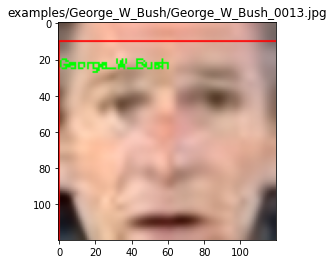

Detecting face  47  out of  90
[INFO] recognizing faces in  examples/George_W_Bush/George_W_Bush_0011.jpg
Correct face recognized


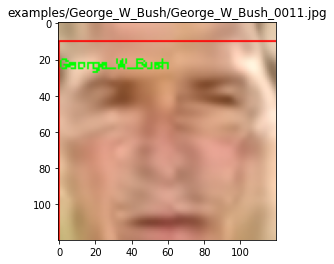

Detecting face  48  out of  90
[INFO] recognizing faces in  examples/George_W_Bush/George_W_Bush_0012.jpg
Correct face recognized


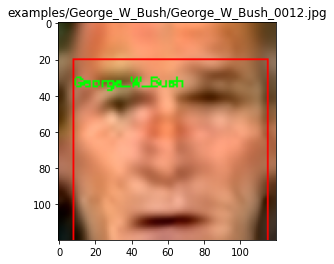

Detecting face  49  out of  90
[INFO] recognizing faces in  examples/Nestor_Kirchner/Nestor_Kirchner_0012.jpg
Correct face recognized


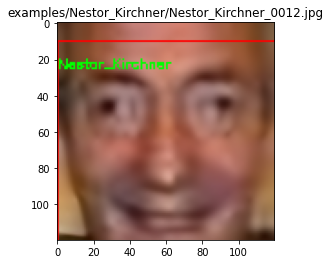

Detecting face  50  out of  90
[INFO] recognizing faces in  examples/Nestor_Kirchner/Nestor_Kirchner_0013.jpg
Correct face recognized


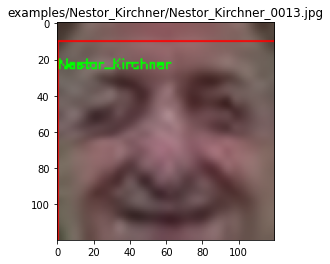

Detecting face  51  out of  90
[INFO] recognizing faces in  examples/Nestor_Kirchner/Nestor_Kirchner_0011.jpg
Correct face recognized


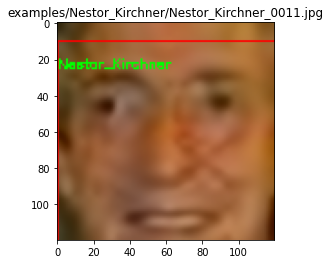

Detecting face  52  out of  90
[INFO] recognizing faces in  examples/Alvaro_Uribe/Alvaro_Uribe_0012.jpg
Correct face recognized


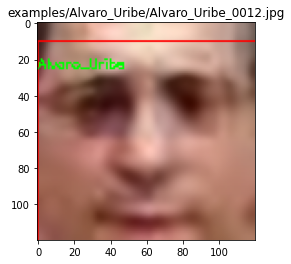

Detecting face  53  out of  90
[INFO] recognizing faces in  examples/Alvaro_Uribe/Alvaro_Uribe_0011.jpg
Correct face recognized


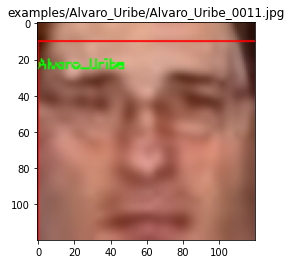

Detecting face  54  out of  90
[INFO] recognizing faces in  examples/Alvaro_Uribe/Alvaro_Uribe_0013.jpg
Correct face recognized


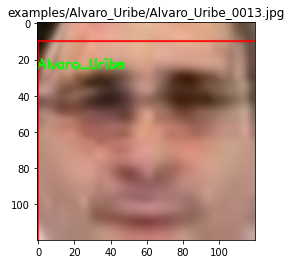

Detecting face  55  out of  90
[INFO] recognizing faces in  examples/Tony_Blair/Tony_Blair_0011.jpg
Correct face recognized


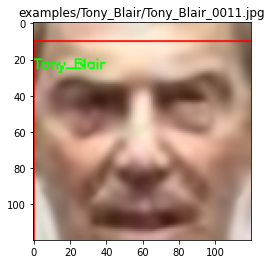

Detecting face  56  out of  90
[INFO] recognizing faces in  examples/Tony_Blair/Tony_Blair_0012.jpg
Correct face recognized


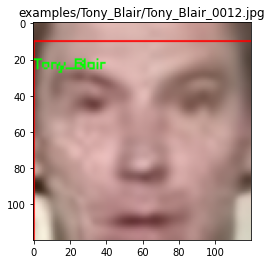

Detecting face  57  out of  90
[INFO] recognizing faces in  examples/Tony_Blair/Tony_Blair_0013.jpg
Correct face recognized


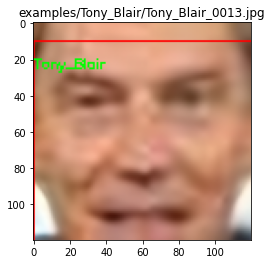

Detecting face  58  out of  90
[INFO] recognizing faces in  examples/Kofi_Annan/Kofi_Annan_0011.jpg
Correct face recognized


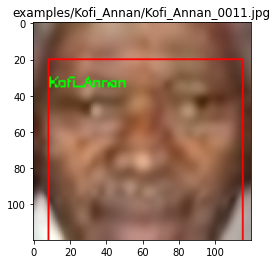

Detecting face  59  out of  90
[INFO] recognizing faces in  examples/Kofi_Annan/Kofi_Annan_0013.jpg
Correct face recognized


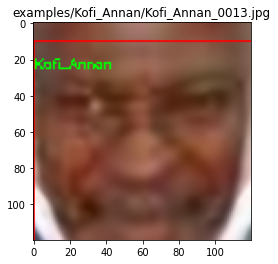

Detecting face  60  out of  90
[INFO] recognizing faces in  examples/Kofi_Annan/Kofi_Annan_0012.jpg
Correct face recognized


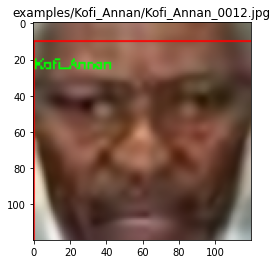

Detecting face  61  out of  90
[INFO] recognizing faces in  examples/Arnold_Schwarzenegger/Arnold_Schwarzenegger_0012.jpg
Correct face recognized


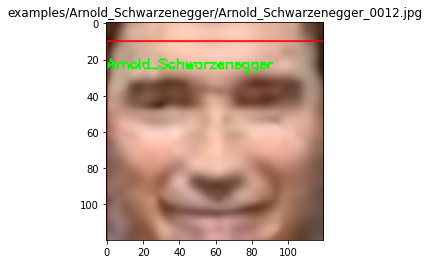

Detecting face  62  out of  90
[INFO] recognizing faces in  examples/Arnold_Schwarzenegger/Arnold_Schwarzenegger_0011.jpg
Folder name is:  ['Arnold_Schwarzenegger'] . However, face detected is: []


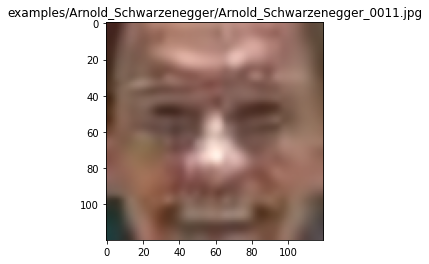

Detecting face  63  out of  90
[INFO] recognizing faces in  examples/Arnold_Schwarzenegger/Arnold_Schwarzenegger_0013.jpg
Folder name is:  ['Arnold_Schwarzenegger'] . However, face detected is: ['Alvaro_Uribe']


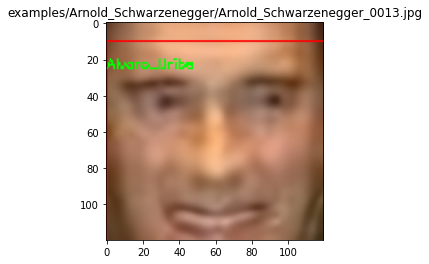

Detecting face  64  out of  90
[INFO] recognizing faces in  examples/Jacques_Chirac/Jacques_Chirac_0011.jpg
Correct face recognized


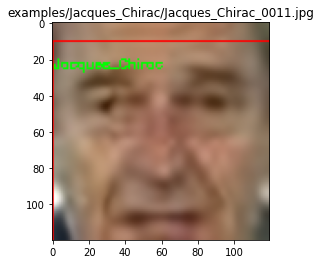

Detecting face  65  out of  90
[INFO] recognizing faces in  examples/Jacques_Chirac/Jacques_Chirac_0013.jpg
Correct face recognized


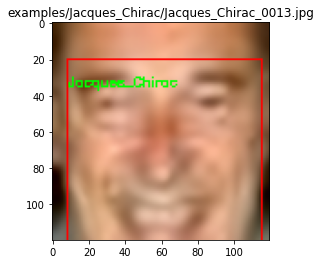

Detecting face  66  out of  90
[INFO] recognizing faces in  examples/Jacques_Chirac/Jacques_Chirac_0012.jpg
Correct face recognized


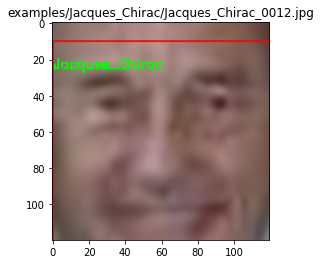

Detecting face  67  out of  90
[INFO] recognizing faces in  examples/Donald_Rumsfeld/Donald_Rumsfeld_0011.jpg
Correct face recognized


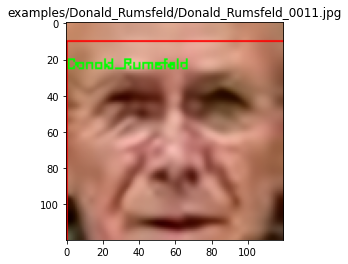

Detecting face  68  out of  90
[INFO] recognizing faces in  examples/Donald_Rumsfeld/Donald_Rumsfeld_0013.jpg
Correct face recognized


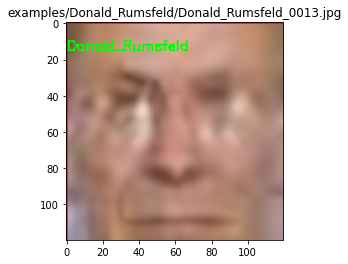

Detecting face  69  out of  90
[INFO] recognizing faces in  examples/Donald_Rumsfeld/Donald_Rumsfeld_0012.jpg
Correct face recognized


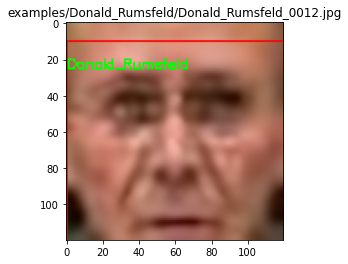

Detecting face  70  out of  90
[INFO] recognizing faces in  examples/Ariel_Sharon/Ariel_Sharon_0013.jpg
Correct face recognized


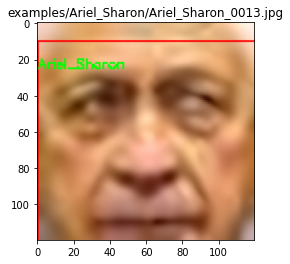

Detecting face  71  out of  90
[INFO] recognizing faces in  examples/Ariel_Sharon/Ariel_Sharon_0011.jpg
Correct face recognized


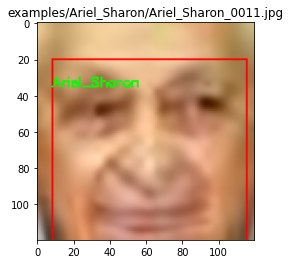

Detecting face  72  out of  90
[INFO] recognizing faces in  examples/Ariel_Sharon/Ariel_Sharon_0012.jpg
Correct face recognized


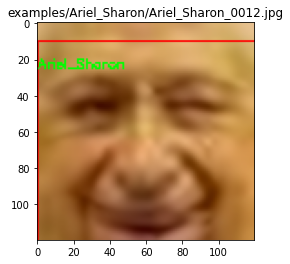

Detecting face  73  out of  90
[INFO] recognizing faces in  examples/Hugo_Chavez/Hugo_Chavez_0011.jpg
Correct face recognized


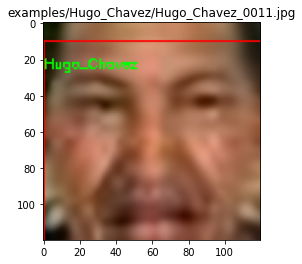

Detecting face  74  out of  90
[INFO] recognizing faces in  examples/Hugo_Chavez/Hugo_Chavez_0012.jpg
Correct face recognized


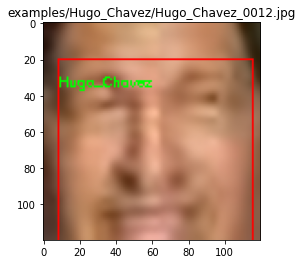

Detecting face  75  out of  90
[INFO] recognizing faces in  examples/Hugo_Chavez/Hugo_Chavez_0013.jpg
Correct face recognized


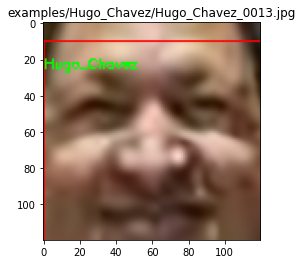

Detecting face  76  out of  90
[INFO] recognizing faces in  examples/Serena_Williams/Serena_Williams_0013.jpg
Correct face recognized


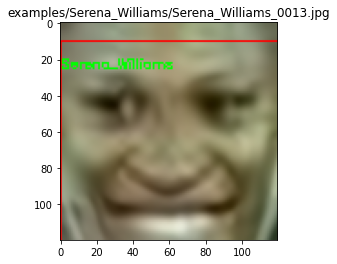

Detecting face  77  out of  90
[INFO] recognizing faces in  examples/Serena_Williams/Serena_Williams_0011.jpg
Folder name is:  ['Serena_Williams'] . However, face detected is: []


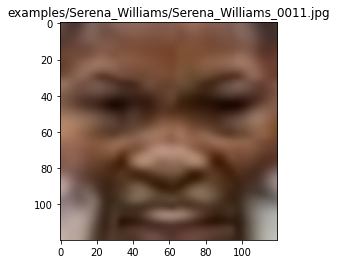

Detecting face  78  out of  90
[INFO] recognizing faces in  examples/Serena_Williams/Serena_Williams_0012.jpg
Folder name is:  ['Serena_Williams'] . However, face detected is: []


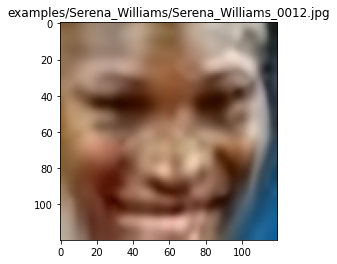

Detecting face  79  out of  90
[INFO] recognizing faces in  examples/Jean_Chretien/Jean_Chretien_0013.jpg
Folder name is:  ['Jean_Chretien'] . However, face detected is: ['Ariel_Sharon']


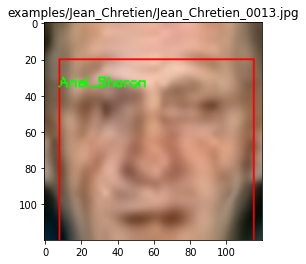

Detecting face  80  out of  90
[INFO] recognizing faces in  examples/Jean_Chretien/Jean_Chretien_0011.jpg
Correct face recognized


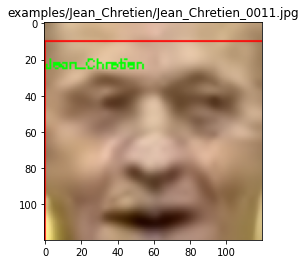

Detecting face  81  out of  90
[INFO] recognizing faces in  examples/Jean_Chretien/Jean_Chretien_0012.jpg
Correct face recognized


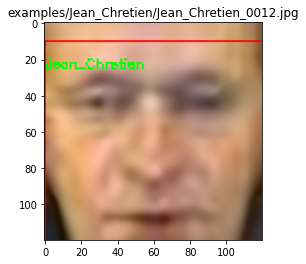

Detecting face  82  out of  90
[INFO] recognizing faces in  examples/Gerhard_Schroeder/Gerhard_Schroeder_0012.jpg
Correct face recognized


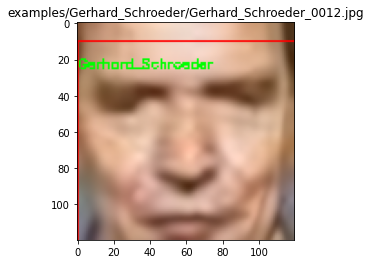

Detecting face  83  out of  90
[INFO] recognizing faces in  examples/Gerhard_Schroeder/Gerhard_Schroeder_0013.jpg
Correct face recognized


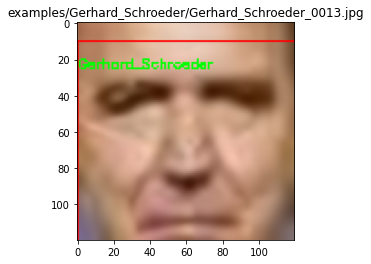

Detecting face  84  out of  90
[INFO] recognizing faces in  examples/Gerhard_Schroeder/Gerhard_Schroeder_0011.jpg
Correct face recognized


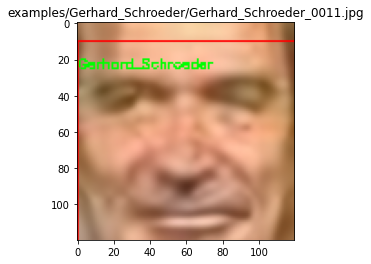

Detecting face  85  out of  90
[INFO] recognizing faces in  examples/Junichiro_Koizumi/Junichiro_Koizumi_0011.jpg
Correct face recognized


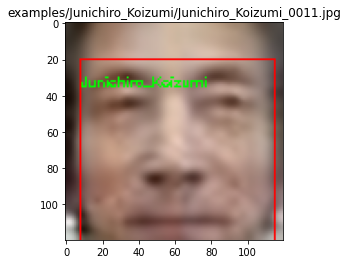

Detecting face  86  out of  90
[INFO] recognizing faces in  examples/Junichiro_Koizumi/Junichiro_Koizumi_0013.jpg
Correct face recognized


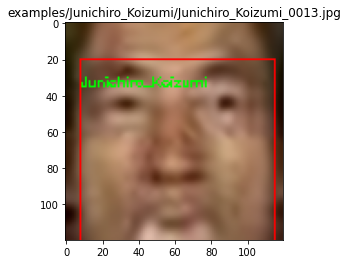

Detecting face  87  out of  90
[INFO] recognizing faces in  examples/Junichiro_Koizumi/Junichiro_Koizumi_0012.jpg
Correct face recognized


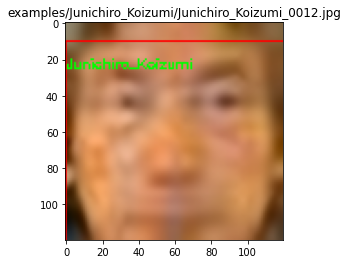

Detecting face  88  out of  90
[INFO] recognizing faces in  examples/Jennifer_Capriati/Jennifer_Capriati_0013.jpg
Correct face recognized


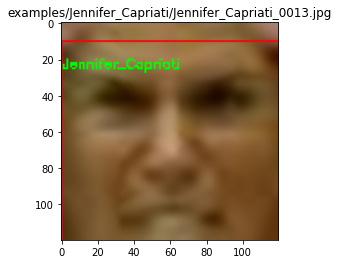

Detecting face  89  out of  90
[INFO] recognizing faces in  examples/Jennifer_Capriati/Jennifer_Capriati_0011.jpg
Correct face recognized


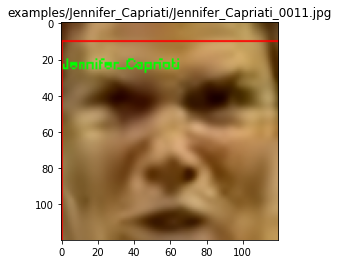

Detecting face  90  out of  90
[INFO] recognizing faces in  examples/Jennifer_Capriati/Jennifer_Capriati_0012.jpg
Correct face recognized


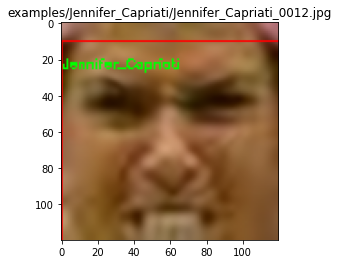

Summary
Total pictures 90
Faces identified correctly:  82
Faces identified wrongly:  4
Faces not identified:  4
Absolute Accuracy (correct / [correct + incorrect + not detected]) * 100%: 
91.0 %
Detection Accuracy [(correct + incorrect) / total] * 100%: 
95.56 %
END, time taken:  307.3 seconds
Avg. secs. per picture:  3.41 seconds


In [20]:
print("Face identification: Scalin with EDSR")
print("=========================================================")
recognize_face("ai", "examples")